*Alonso Evan*

*08/04/2020*


----------

![](https://miro.medium.com/max/1400/1*6MhMo5ymoko5XpZnlBcucg.png)

Within the arising COVID-19 pandemia, Kaggle has launched the COVID-19 Open Research Dataset Challenge (CORD-19) dataset as a general call for any data scientist that is able to contribute extracting relevant information to deal with the virus.

With more than 600 kernels and around 230 discussion at the moment, this topic surely give attention.

## Goal

Given a large amount of literature and rapidly spreading COVID-19, it is difficult for a scientist to keep up with the research community promptly. Can we cluster similar research articles together to make it easier for health professionals to find relevant research articles? Clustering can be used to create a tool to identify similar articles, given a target article. It can also reduce the number of articles one has to go through as one can focus on a cluster of articles rather than all.

*Approach*:

- Unsupervised Learning task, because we don't have labels for the articles
- Clustering and Dimensionality Reduction task
- See how well labels from K-Means classify
- Use N-Grams with Hash Vectorizer
- Use plain text with Tf-idf
- Use K-Means for clustering
- Use t-SNE for dimensionality reduction
- Use PCA for dimensionality reduction
- Use interactive plot to have more readable results
- Use Doc2Vec
- Use AgglomerativeClustering
- Use SpectralClustering 

*Goal*

Given a large amount of literature and rapidly spreading COVID-19, it is difficult for a scientist to keep up with the research community promptly. Can we cluster similar research articles together to make it easier for health professionals to find 
Dataset Description
In response to the COVID-19 pandemic, the White House and a coalition of leading research groups have prepared the COVID-19 Open Research Dataset (CORD-19). CORD-19 is a resource of over 29,000 scholarly articles, including over 13,000 with full text, about COVID-19, SARS-CoV-2, and related coronaviruses. This freely available dataset is provided to the global research community to apply recent advances in natural language processing and other AI techniques to generate new insights in support of the ongoing fight against this infectious disease. There is a growing urgency for these approaches because of the rapid acceleration in new coronavirus literature, making it difficult for the medical research community to keep up.

Cite: COVID-19 Open Research Dataset Challenge (CORD-19) | Kaggle

## Corona Virus

- Coronaviruses are zoonotic viruses (means transmitted between animals and people).
- Symptoms include from fever, cough, respiratory symptoms, and breathing difficulties.
- In severe cases, it can cause pneumonia, severe acute respiratory syndrome (SARS), kidney failure and even death.
- Coronaviruses are also asymptomatic, means a person can be a carrier for the infection but experiences no symptoms

Here are the symptoms associated with COVID-19 and how they compare  with those of the flu, allergies, and the common cold

![](https://i.insider.com/5e6a58e684159f61963287a2?width=1000&format=jpeg&auto=webp)


![](https://ichef.bbci.co.uk/news/640/cpsprodpb/16F8F/production/_111059049_corona_virus_symptoms_short_v4_640-nc.png)


*As a NLP beginner, In this notebook i will try to apply various Document Clustering techniques*

**Why Document Clustering?**

Document Clustering is really important for that moment. Because it would be one of the best mechanisms that will be a great support in exploring the insights for delivering the answers about coronavirus.
Clustering is a good choice for handling a large number of research papers.

Now, it's the very crucial time. I am also trying to be a part to help answering the questions about corona virus. By doing so, we can establish new ways to stop Corona Virus.

1. [Import packages](#1)
1. [Load data](#2)
    - Fetch All of JSON File Path
    - Helper Functions
    - Load the Data into DataFrame
    - Adding the Word Count Columns
    - Handle Possible Duplicates
1. [Exploring the data](#8)
    - Most Frequent Words in Title
    - Most Frequent Words in abstract
    - Most Frequent Words in body_text
1. [Preprocessing the data](#3)
    - 2-Grams
1. [Dimensionality Reduction with t-SNE](#4)
1. [Unsupervised Learning: Clustering with K-Means](#5)
1. [Model's performances](#6)
1. [MiniBatchKMeans Using Tf-idf with Plain Text](#7)
    - PCA 
    - Dimensionality Reduction with t-SNE (Plain text and Tf-idf)
    - Model's performances
    - Dimensionality Reduction with PCA (Plain text and Tf-idf)
    - More Clusters?
    - Result's analyse with 10 clusters 
    - Interactive scatter plot of t-SNE with 10 clusters
1. [Doc2Vec for Text Representation and KMeans Clustering](#9)
    - Dimensionality Reduction with t-SNE (Doc2Vec)
    - Dimensionality Reduction with PCA (Doc2Vec)
1. [AgglomerativeClustering with TF-IDF](#11)
1. [SpectralClustering with TF-IDF](#12)

<a id="1"></a> <br>
## Import packages

In [1]:
import numpy as np 
import pandas as pd 
import glob
import json
import wordcloud
import random 
import string, collections
import re
import nltk

from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk import FreqDist
from nltk.util import ngrams
from nltk.stem import WordNetLemmatizer

from wordcloud import WordCloud

import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('ggplot')
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import SpectralClustering

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import HashingVectorizer
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import precision_score, recall_score



import gensim
from gensim.models import Doc2Vec


#interactive plot with bokeh
from bokeh.models import ColumnDataSource, HoverTool, LinearColorMapper, CustomJS
from bokeh.palettes import Category20
from bokeh.transform import linear_cmap
from bokeh.io import output_file, show
from bokeh.transform import transform
from bokeh.io import output_notebook
from bokeh.plotting import figure
from bokeh.layouts import column
from bokeh.models import RadioButtonGroup
from bokeh.models import TextInput
from bokeh.layouts import gridplot
from bokeh.models import Div
from bokeh.models import Paragraph
from bokeh.layouts import column, widgetbox

<a id="2"></a> <br>
## Load data

In [2]:
root_path = 'CORD-19-research-challenge/'
metadata_path = f'{root_path}/metadata.csv'
meta_df = pd.read_csv(metadata_path, dtype={
    'pubmed_id': str,
    'Microsoft Academic Paper ID': str, 
    'doi': str
})
meta_df.head()

,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,Microsoft Academic Paper ID,WHO #Covidence,has_full_text,full_text_file
0,NaN,Elsevier,Intrauterine virus infections and congenital h...,10.1016/0002-8703(72)90077-4,NaN,4361535,els-covid,Abstract The etiologic basis for the vast majo...,1972-12-31,"Overall, James C.",American Heart Journal,NaN,NaN,False,custom_license
1,NaN,Elsevier,Coronaviruses in Balkan nephritis,10.1016/0002-8703(80)90355-5,NaN,6243850,els-covid,NaN,1980-03-31,"Georgescu, Leonida; Diosi, Peter; Buţiu, Ioan;...",American Heart Journal,NaN,NaN,False,custom_license
2,NaN,Elsevier,Cigarette smoking and coronary heart disease: ...,10.1016/0002-8703(80)90356-7,NaN,7355701,els-covid,NaN,1980-03-31,"Friedman, Gary D",American Heart Journal,NaN,NaN,False,custom_license
3,aecbc613ebdab36753235197ffb4f35734b5ca63,Elsevier,Clinical and immunologic studies in identical ...,10.1016/0002-9343(73)90176-9,NaN,4579077,els-covid,"Abstract Middle-aged female identical twins, o...",1973-08-31,"Brunner, Carolyn M.; Horwitz, David A.; Shann,...",The American Journal of Medicine,NaN,NaN,True,custom_license
4,NaN,Elsevier,Epidemiology of community-acquired respiratory...,10.1016/0002-9343(85)90361-4,NaN,4014285,els-covid,Abstract Upper respiratory tract infections ar...,1985-06-28,"Garibaldi, Richard A.",The American Journal of Medicine,NaN,NaN,False,custom_license


In [7]:
meta_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44220 entries, 0 to 44219
Data columns (total 15 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   sha                          28462 non-null  object
 1   source_x                     44220 non-null  object
 2   title                        43996 non-null  object
 3   doi                          40750 non-null  object
 4   pmcid                        23319 non-null  object
 5   pubmed_id                    22943 non-null  object
 6   license                      44220 non-null  object
 7   abstract                     35806 non-null  object
 8   publish_time                 34197 non-null  object
 9   authors                      41074 non-null  object
 10  journal                      33173 non-null  object
 11  Microsoft Academic Paper ID  964 non-null    object
 12  WHO #Covidence               1767 non-null   object
 13  has_full_text                44

**Fetch All of JSON File Path**

Get path to all JSON files:

In [3]:
all_json = glob.glob(f'{root_path}/**/*.json', recursive=True)
len(all_json)

29315

**Helper Functions**

File Reader Class

In [4]:
class FileReader:
    def __init__(self, file_path):
        with open(file_path) as file:
            content = json.load(file)
            self.paper_id = content['paper_id']
            self.abstract = []
            self.body_text = []
            # Abstract
            for entry in content['abstract']:
                self.abstract.append(entry['text'])
            # Body text
            for entry in content['body_text']:
                self.body_text.append(entry['text'])
            self.abstract = '\n'.join(self.abstract)
            self.body_text = '\n'.join(self.body_text)
    def __repr__(self):
        return f'{self.paper_id}: {self.abstract[:200]}... {self.body_text[:200]}...'
first_row = FileReader(all_json[0])
print(first_row)

0015023cc06b5362d332b3baf348d11567ca2fbb: word count: 194 22 Text word count: 5168 23 24 25 author/funder. All rights reserved. No reuse allowed without permission. Abstract 27 The positive stranded RNA genomes of picornaviruses comprise a si... VP3, and VP0 (which is further processed to VP2 and VP4 during virus assembly) (6). The P2 64 and P3 regions encode the non-structural proteins 2B and 2C and 3A, 3B (1-3) (VPg), 3C pro and 4 structura...


Helper function adds break after every words when character length reach to certain amount.

In [5]:
def get_breaks(content, length):
    data = ""
    words = content.split(' ')
    total_chars = 0

    # add break every length characters
    for i in range(len(words)):
        total_chars += len(words[i])
        if total_chars > length:
            data = data + "<br>" + words[i]
            total_chars = 0
        else:
            data = data + " " + words[i]
    return data

**Load the Data into DataFrame**

Using the helper functions, let's read in the articles into a DataFrame that can be used easily:

In [6]:
dict_ = {'paper_id': [], 'abstract': [], 'body_text': [], 'authors': [], 'title': [], 'journal': [], 'abstract_summary': []}

for idx, entry in enumerate(all_json):
    if idx % (len(all_json) // 10) == 0:
        print(f'Processing index: {idx} of {len(all_json)}')
    content = FileReader(entry)
    
    # get metadata information
    meta_data = meta_df.loc[meta_df['sha'] == content.paper_id]
    # no metadata, skip this paper
    if len(meta_data) == 0:
        continue
    
    dict_['paper_id'].append(content.paper_id)
    dict_['abstract'].append(content.abstract)
    dict_['body_text'].append(content.body_text)
    
    # also create a column for the summary of abstract to be used in a plot
    if len(content.abstract) == 0: 
        # no abstract provided
        dict_['abstract_summary'].append("Not provided.")
    elif len(content.abstract.split(' ')) > 100:
        # abstract provided is too long for plot, take first 300 words append with ...
        info = content.abstract.split(' ')[:100]
        summary = get_breaks(' '.join(info), 40)
        dict_['abstract_summary'].append(summary + "...")
    else:
        # abstract is short enough
        summary = get_breaks(content.abstract, 40)
        dict_['abstract_summary'].append(summary)
        
    # get metadata information
    meta_data = meta_df.loc[meta_df['sha'] == content.paper_id]
    
    try:
        # if more than one author
        authors = meta_data['authors'].values[0].split(';')
        if len(authors) > 2:
            # more than 2 authors, may be problem when plotting, so take first 2 append with ...
            dict_['authors'].append(". ".join(authors[:2]) + "...")
        else:
            # authors will fit in plot
            dict_['authors'].append(". ".join(authors))
    except Exception as e:
        # if only one author - or Null valie
        dict_['authors'].append(meta_data['authors'].values[0])
    
    # add the title information, add breaks when needed
    try:
        title = get_breaks(meta_data['title'].values[0], 40)
        dict_['title'].append(title)
    # if title was not provided
    except Exception as e:
        dict_['title'].append(meta_data['title'].values[0])
    
    # add the journal information
    dict_['journal'].append(meta_data['journal'].values[0])
    
df_covid = pd.DataFrame(dict_, columns=['paper_id', 'abstract', 'body_text', 'authors', 'title', 'journal', 'abstract_summary'])
df_covid.head()

Processing index: 0 of 29315
Processing index: 2931 of 29315
Processing index: 5862 of 29315
Processing index: 8793 of 29315
Processing index: 11724 of 29315
Processing index: 14655 of 29315
Processing index: 17586 of 29315
Processing index: 20517 of 29315
Processing index: 23448 of 29315
Processing index: 26379 of 29315
Processing index: 29310 of 29315


,paper_id,abstract,body_text,authors,title,journal,abstract_summary
0,0015023cc06b5362d332b3baf348d11567ca2fbb,word count: 194 22 Text word count: 5168 23 24...,"VP3, and VP0 (which is further processed to VP...","Ward, J. C. J.. Lasecka-Dykes, L....",The RNA pseudoknots in foot-and-mouth disease...,NaN,word count: 194 22 Text word count: 5168 23 2...
1,004f0f8bb66cf446678dc13cf2701feec4f36d76,,The 2019-nCoV epidemic has spread across China...,Hanchu Zhou. Jianan Yang...,Healthcare-resource-adjusted<br>vulnerabiliti...,NaN,Not provided.
2,00d16927588fb04d4be0e6b269fc02f0d3c2aa7b,Infectious bronchitis (IB) causes significant ...,"Infectious bronchitis (IB), which is caused by...","Butt, S. L.. Erwood, E. C....","Real-time, MinION-based, amplicon<br>sequenci...",NaN,Infectious bronchitis (IB) causes<br>signific...
3,0139ea4ca580af99b602c6435368e7fdbefacb03,Nipah Virus (NiV) came into limelight recently...,Nipah is an infectious negative-sense single-s...,Nishi Kumari. Ayush Upadhyay...,A Combined Evidence Approach to Prioritize<br...,NaN,Nipah Virus (NiV) came into limelight recentl...
4,013d9d1cba8a54d5d3718c229b812d7cf91b6c89,Background: A novel coronavirus (2019-nCoV) em...,"In December 2019, a cluster of patients with p...",Shengjie Lai. Isaac Bogoch...,Assessing spread risk of Wuhan novel<br>coron...,NaN,Background: A novel coronavirus (2019-nCoV)<b...


In [7]:
dict_ = None

**Adding the Word Count Columns**

Adding word count columns for both abstract and body_text can be useful parameters later:

In [8]:
df_covid['abstract_word_count'] = df_covid['abstract'].apply(lambda x: len(x.strip().split()))
df_covid['body_word_count'] = df_covid['body_text'].apply(lambda x: len(x.strip().split()))
df_covid.head()

,paper_id,abstract,body_text,authors,title,journal,abstract_summary,abstract_word_count,body_word_count
0,0015023cc06b5362d332b3baf348d11567ca2fbb,word count: 194 22 Text word count: 5168 23 24...,"VP3, and VP0 (which is further processed to VP...","Ward, J. C. J.. Lasecka-Dykes, L....",The RNA pseudoknots in foot-and-mouth disease...,NaN,word count: 194 22 Text word count: 5168 23 2...,241,1728
1,004f0f8bb66cf446678dc13cf2701feec4f36d76,,The 2019-nCoV epidemic has spread across China...,Hanchu Zhou. Jianan Yang...,Healthcare-resource-adjusted<br>vulnerabiliti...,NaN,Not provided.,0,755
2,00d16927588fb04d4be0e6b269fc02f0d3c2aa7b,Infectious bronchitis (IB) causes significant ...,"Infectious bronchitis (IB), which is caused by...","Butt, S. L.. Erwood, E. C....","Real-time, MinION-based, amplicon<br>sequenci...",NaN,Infectious bronchitis (IB) causes<br>signific...,1647,4003
3,0139ea4ca580af99b602c6435368e7fdbefacb03,Nipah Virus (NiV) came into limelight recently...,Nipah is an infectious negative-sense single-s...,Nishi Kumari. Ayush Upadhyay...,A Combined Evidence Approach to Prioritize<br...,NaN,Nipah Virus (NiV) came into limelight recentl...,326,2399
4,013d9d1cba8a54d5d3718c229b812d7cf91b6c89,Background: A novel coronavirus (2019-nCoV) em...,"In December 2019, a cluster of patients with p...",Shengjie Lai. Isaac Bogoch...,Assessing spread risk of Wuhan novel<br>coron...,NaN,Background: A novel coronavirus (2019-nCoV)<b...,22,4642


In [15]:
df_covid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27678 entries, 0 to 27677
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   paper_id             27678 non-null  object
 1   abstract             27678 non-null  object
 2   body_text            27678 non-null  object
 3   authors              26929 non-null  object
 4   title                27634 non-null  object
 5   journal              26784 non-null  object
 6   abstract_summary     27678 non-null  object
 7   abstract_word_count  27678 non-null  int64 
 8   body_word_count      27678 non-null  int64 
dtypes: int64(2), object(7)
memory usage: 1.9+ MB


In [16]:
df_covid.abstract.describe(include = 'all')

count     27678
unique    20191
top            
freq       7453
Name: abstract, dtype: object

**Handle Possible Duplicates**

When we look at the unique values above, we can see that there are duplicates. It may have caused because of author submiting the article to multiple journals. Let's remove the duplicats from our dataset:

In [9]:
df_covid.drop_duplicates(['abstract', 'body_text'], inplace=True)
df_covid['abstract'].describe(include='all')

count     27663
unique    20191
top            
freq       7444
Name: abstract, dtype: object

In [18]:
df_covid['body_text'].describe(include='all')

count                                                 27663
unique                                                27662
top       In a global world, knowledge of imported infec...
freq                                                      2
Name: body_text, dtype: object

It looks like we didn't have duplicates. Instead, it was articles without Abstracts.

<a id="8"></a> <br>
## Exploring the data

In [19]:
df_covid.head()

,paper_id,abstract,body_text,authors,title,journal,abstract_summary,abstract_word_count,body_word_count
0,0015023cc06b5362d332b3baf348d11567ca2fbb,word count: 194 22 Text word count: 5168 23 24...,"VP3, and VP0 (which is further processed to VP...","Ward, J. C. J.. Lasecka-Dykes, L....",The RNA pseudoknots in foot-and-mouth disease...,NaN,word count: 194 22 Text word count: 5168 23 2...,241,1728
1,004f0f8bb66cf446678dc13cf2701feec4f36d76,,The 2019-nCoV epidemic has spread across China...,Hanchu Zhou. Jianan Yang...,Healthcare-resource-adjusted<br>vulnerabiliti...,NaN,Not provided.,0,755
2,00d16927588fb04d4be0e6b269fc02f0d3c2aa7b,Infectious bronchitis (IB) causes significant ...,"Infectious bronchitis (IB), which is caused by...","Butt, S. L.. Erwood, E. C....","Real-time, MinION-based, amplicon<br>sequenci...",NaN,Infectious bronchitis (IB) causes<br>signific...,1647,4003
3,0139ea4ca580af99b602c6435368e7fdbefacb03,Nipah Virus (NiV) came into limelight recently...,Nipah is an infectious negative-sense single-s...,Nishi Kumari. Ayush Upadhyay...,A Combined Evidence Approach to Prioritize<br...,NaN,Nipah Virus (NiV) came into limelight recentl...,326,2399
4,013d9d1cba8a54d5d3718c229b812d7cf91b6c89,Background: A novel coronavirus (2019-nCoV) em...,"In December 2019, a cluster of patients with p...",Shengjie Lai. Isaac Bogoch...,Assessing spread risk of Wuhan novel<br>coron...,NaN,Background: A novel coronavirus (2019-nCoV)<b...,22,4642


In [20]:
df_covid.describe()

,abstract_word_count,body_word_count
count,27663.000000,27663.000000
mean,165.454325,4886.198026
std,175.660928,7494.247433
min,0.000000,1.000000
25%,0.000000,2503.500000
50%,162.000000,3760.000000
75%,240.000000,5531.000000
max,4767.000000,260378.000000


**Most Frequent Words in Title**

The following wordcloud shows the most frequent words within the titles.

In [58]:
stop_words = set(stopwords.words('english'))


df_covid.dropna(inplace=True)

df_covid['title'] = df_covid['title'].apply(lambda x: re.sub('[^a-zA-z0-9\s]','',x))

In [60]:
title = ""
for titre in df_covid.title:
    title = title + titre

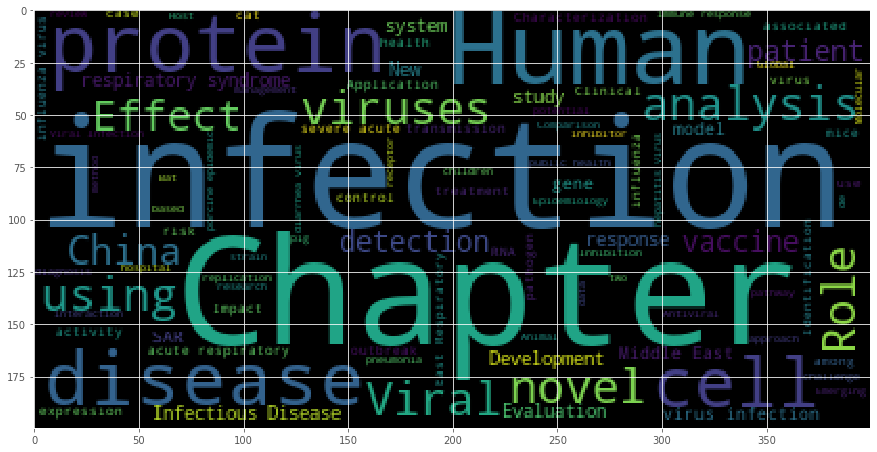

In [65]:
wx = WordCloud(stopwords = stop_words)

plt.figure(figsize = (15,20))
wx.generate(title)
plt.imshow(wx)
plt.show()

Protein ? Yes because the virus is surrounded by protein who aim to be fixed to our body. So that make sense. The others like infection, human, chapter and so on are inherent.

**Most Frequent Words in abstract**

The following wordcloud shows the most frequent words within the abstract of tagged articles.

In [69]:
df_covid['abstract'] = df_covid['abstract'].apply(lambda x: re.sub('[^a-zA-z0-9\s]','',x))

title = ""
for titre in df_covid.abstract:
    title = title + titre

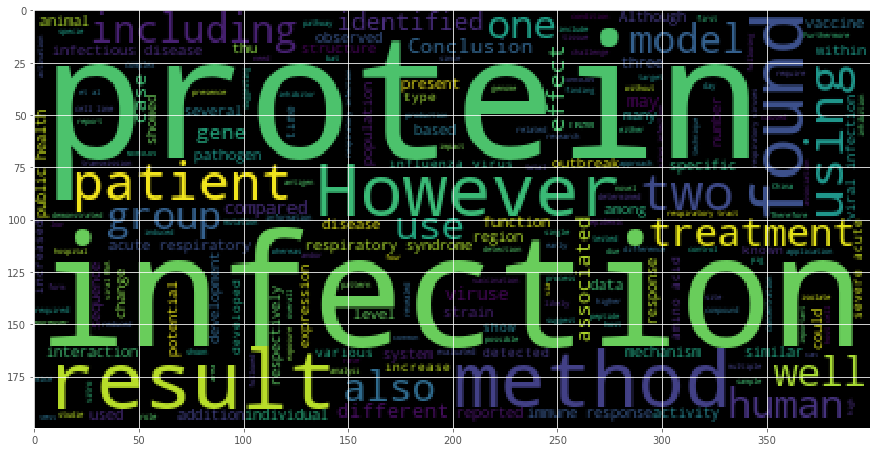

In [73]:
wx = WordCloud(stopwords = stop_words)

plt.figure(figsize = (15,20))
wx.generate(title)
plt.imshow(wx)
plt.show()

Protein is much more involved here.

## Most Frequent Words in body_text
The following wordcloud shows the most frequent words within the body_text of tagged articles.

In [74]:
df_covid['body_text'] = df_covid['body_text'].apply(lambda x: re.sub('[^a-zA-z0-9\s]','',x))

title = ""
for titre in df_covid.body_text:
    title = title + titre

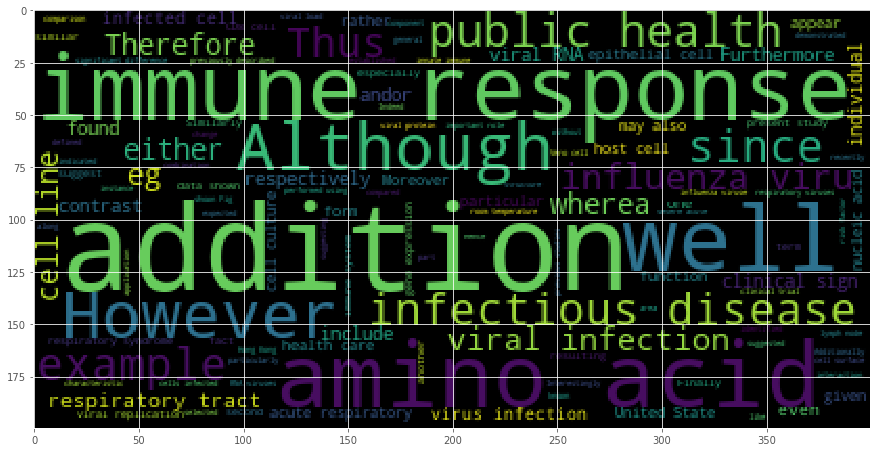

In [79]:
stop_words.update(("et", "al", "de", "la", "Thu", "ie"))

wx = WordCloud(stopwords = stop_words)

plt.figure(figsize = (15,20))
wx.generate(title)
plt.imshow(wx)
plt.show()

<a id="3"></a> <br>

## Data Pre-processing

Now that we have our dataset loaded, we need to clean-up the text to improve any clustering or classification efforts. First, let's drop Null vales:

In [10]:
df_covid.dropna(inplace=True)
df_covid.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26044 entries, 885 to 27677
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   paper_id             26044 non-null  object
 1   abstract             26044 non-null  object
 2   body_text            26044 non-null  object
 3   authors              26044 non-null  object
 4   title                26044 non-null  object
 5   journal              26044 non-null  object
 6   abstract_summary     26044 non-null  object
 7   abstract_word_count  26044 non-null  int64 
 8   body_word_count      26044 non-null  int64 
dtypes: int64(2), object(7)
memory usage: 2.0+ MB


I will limit the number of articles to speed up computation. 

In [ ]:
df_covid = df_covid.head(13000)

Now let's remove punctuation from each text:

(I already did that for workcloud but for clarity, I will do that again here)

In [11]:
df_covid['body_text'] = df_covid['body_text'].apply(lambda x: re.sub('[^a-zA-z0-9\s]','',x))
df_covid['abstract'] = df_covid['abstract'].apply(lambda x: re.sub('[^a-zA-z0-9\s]','',x))

Convert each text to lower case:

In [12]:
def lower_case(input_str):
    input_str = input_str.lower()
    return input_str

df_covid['body_text'] = df_covid['body_text'].apply(lambda x: lower_case(x))
df_covid['abstract'] = df_covid['abstract'].apply(lambda x: lower_case(x))

Let's see how it goes :

In [26]:
df_covid.head()

,paper_id,abstract,body_text,authors,title,journal,abstract_summary,abstract_word_count,body_word_count
885,00142f93c18b07350be89e96372d240372437ed9,dendritic cells dcs are specialized antigenpre...,introduction human beings are constantly expos...,"Geginat, Jens. Nizzoli, Giulia...",Immunity to Pathogens Taught by Specialized<b...,Front Immunol,Dendritic cells (DCs) are specialized<br>anti...,309,5305
886,0022796bb2112abd2e6423ba2d57751db06049fb,dengue has a negative impact in lowand lower m...,pathogens and vectors can now be transported r...,"Viennet, Elvina. Ritchie, Scott A....",Public Health Responses to and Challenges for...,PLoS Negl Trop Dis,Dengue has a negative impact in low-and lower...,276,7288
887,00326efcca0852dc6e39dc6b7786267e1bc4f194,fifteen years ago united nations world leaders...,in addition to preventative care and nutrition...,"Turner, Erin L.. Nielsen, Katie R....",A Review of Pediatric Critical Care in<br>Res...,Front Pediatr,"Fifteen years ago, United Nations world<br>le...",151,7593
888,00352a58c8766861effed18a4b079d1683fec2ec,posttranslational modification of proteins by ...,ubiquitination is a widely used posttranslatio...,"Hodul, Molly. Dahlberg, Caroline L....",Function of the Deubiquitinating Enzyme USP46...,Front Synaptic Neurosci,Posttranslational modification of proteins<br...,148,3156
889,0043d044273b8eb1585d3a66061e9b4e03edc062,background tuberculosis is a devastating disea...,the ministry of health of the peoples republic...,"Yang, Yu Rong. McManus, Donald P...",Evaluation of the tuberculosis programme in<b...,BMC Public Health,Background: Tuberculosis is a devastating<br>...,264,3178


Now that we have the text cleaned up, we can create our features vector which can be fed into a clustering or dimensionality reduction algorithm. For our first try, we will focus on the text on the body of the articles. Let's grab that:

In [ ]:
text = df_covid.drop(["paper_id", "abstract", "abstract_word_count", "body_word_count", "authors", "title", "journal", "abstract_summary"], axis=1)

In [28]:
text.head()

,body_text
885,introduction human beings are constantly expos...
886,pathogens and vectors can now be transported r...
887,in addition to preventative care and nutrition...
888,ubiquitination is a widely used posttranslatio...
889,the ministry of health of the peoples republic...


Let's transform 1D DataFrame into 1D list where each index is an article (instance), so that we can work with words from each instance:

In [29]:
text_arr = text.stack().tolist()
len(text_arr)

13000

**2-Grams**

Let's create 2D list, where each row is instance and each column is a word. Meaning, we will separate each instance into words:

(If you have a huge database, I will only recommand 2-grams if you have a good computer because it highly increase the calcul computation and not necessarily increase performances but here I reduced my database and I've a good computer so I will try because it could be beneficial)

In [31]:
words = []
for ii in range(0,len(text)):
    words.append(str(text.iloc[ii]['body_text']).split(" "))

In [38]:
print(words[0][:10])

['introduction', 'human', 'beings', 'are', 'constantly', 'exposed', 'to', 'a', 'myriad', 'of']


What we want now is n-grams from the words where n=2 (2-gram). We will still have 2D array where each row is an instance; however, each index in that row going to be a 2-gram:

In [39]:
n_gram_all = []

for word in words:
    # get n-grams for the instance
    n_gram = []
    for i in range(len(word)-2+1):
        n_gram.append("".join(word[i:i+2]))
    n_gram_all.append(n_gram)

In [41]:
n_gram_all[0][:10]

['introductionhuman',
 'humanbeings',
 'beingsare',
 'areconstantly',
 'constantlyexposed',
 'exposedto',
 'toa',
 'amyriad',
 'myriadof',
 'ofpathogens']

We can see that there are made by a couple of words.

**Vectorize with HashingVectorizer**

Now we will use HashVectorizer to create the features vector X. For now, let's limit the feature size to 2**12 (4096) to speed up the computation. We might need to increase this later to improve the accuracy:

In [42]:
# hash vectorizer instance
hvec = HashingVectorizer(lowercase=False, analyzer=lambda l:l, n_features=2**12)

# features matrix X
X = hvec.fit_transform(n_gram_all)

In [43]:
X.shape

(13000, 4096)

In [90]:
# test set size of 20% of the data and the random seed 42 
X_train, X_test = train_test_split(X.toarray(), test_size=0.2, random_state=42)

print("X_train size:", len(X_train))
print("X_test size:", len(X_test), "\n")

X_train size: 10400
X_test size: 2600 



<a id="4"></a> <br>
## Dimensionality Reduction with t-SNE

Using t-SNE we can reduce our high dimensional features vector into 2 dimensional plane, this is very useful for interpretation purpose. In the process, t-SNE will keep similar instances together while trying to push different instances far from each other. Resulting 2-D plane can be useful to see which articles cluster near each other:

In [45]:
tsne = TSNE(verbose=1, perplexity=5)
X_embedded = tsne.fit_transform(X_train)

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 10400 samples in 43.414s...
[t-SNE] Computed neighbors for 10400 samples in 1694.744s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10400
[t-SNE] Computed conditional probabilities for sample 2000 / 10400
[t-SNE] Computed conditional probabilities for sample 3000 / 10400
[t-SNE] Computed conditional probabilities for sample 4000 / 10400
[t-SNE] Computed conditional probabilities for sample 5000 / 10400
[t-SNE] Computed conditional probabilities for sample 6000 / 10400
[t-SNE] Computed conditional probabilities for sample 7000 / 10400
[t-SNE] Computed conditional probabilities for sample 8000 / 10400
[t-SNE] Computed conditional probabilities for sample 9000 / 10400
[t-SNE] Computed conditional probabilities for sample 10000 / 10400
[t-SNE] Computed conditional probabilities for sample 10400 / 10400
[t-SNE] Mean sigma: 0.135999
[t-SNE] KL divergence after 250 iterations with early exaggeration: 142.730042
[t-SNE

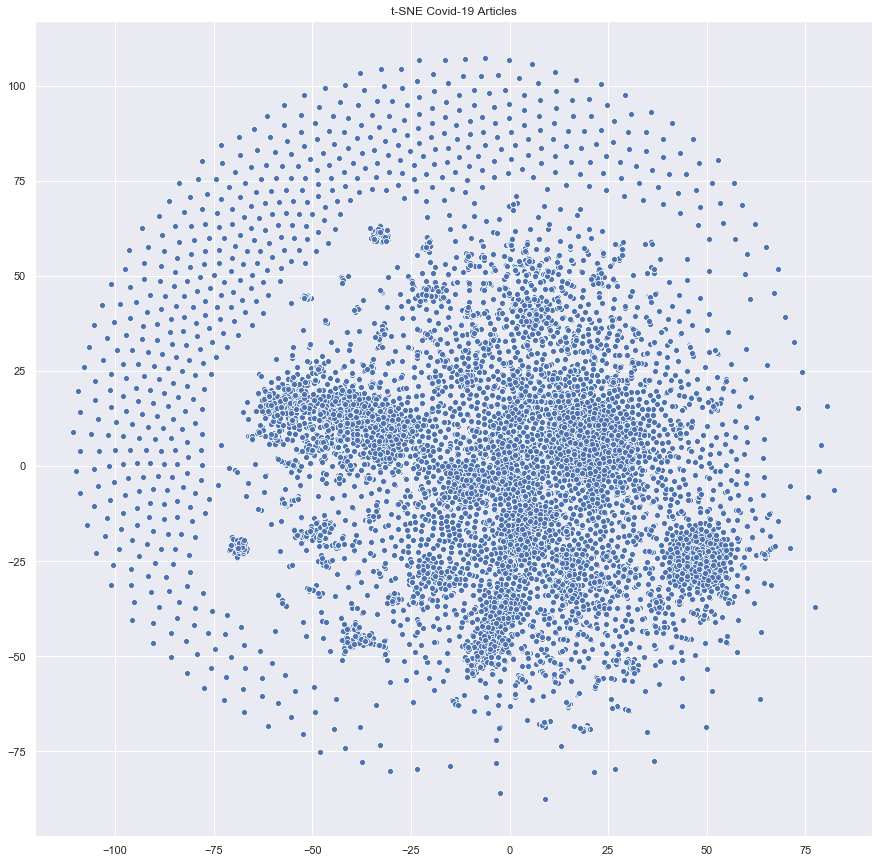

In [47]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# colors
palette = sns.color_palette("bright", 1)

# plot
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], palette=palette)

plt.title("t-SNE Covid-19 Articles")
# plt.savefig("plots/t-sne_covid19.png")
plt.show()

We can clearly see few clusters forming. This may be a good sign that we are able to cluster similar articles together using 2-grams and HashVectorizer with 2**10 features. However, without labels it is difficult to see the clusters. For now, it looks like a blob of data... Let's try if we can use K-Means to generate our labels. We can later use this information to produce a scatterplot with labels to verify the clusters.

<a id="5"></a> <br>
## Unsupervised Learning: Clustering with K-Means

K-means clustering is one of the simplest and popular unsupervised machine learning algorithms.

The algorithm works as follows:

- First we initialize k points, called means, randomly.
- We categorize each item to its closest mean and we update the mean’s coordinates, which are the averages of the items categorized in that mean so far.
- We repeat the process for a given number of iterations and at the end, we have our clusters.

First, we need to find the optimal number of Clusters, this is a fundamental step for any unsupervised algorithm. For this we have the notorious Elbow methods. We build the Elbow curve to get the right number of Clusters :

In [63]:
cost = []

for k in range (1,12):
    kmeans = KMeans(n_clusters=k, n_jobs=4).fit(X_train)
    cost.append(kmeans.inertia_)

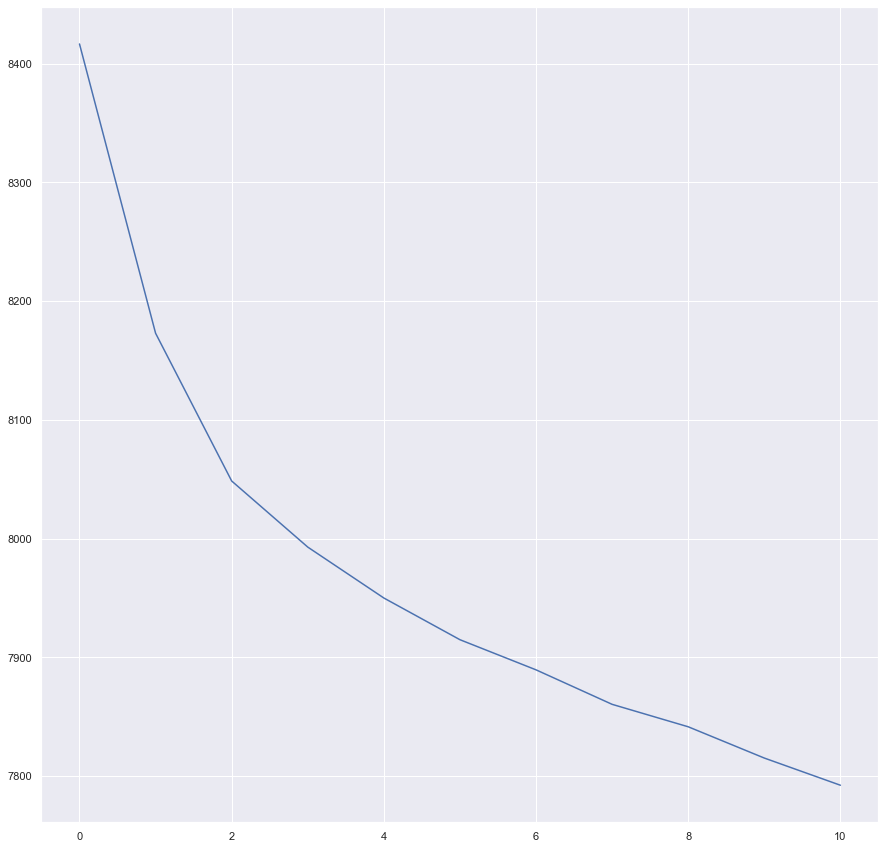

In [64]:
plt.plot(cost);

2 seems good but I think it's too low for this project, 10 seems much more optimal.

In [65]:
k = 10
kmeans = KMeans(n_clusters=k, n_jobs=4)
y_pred = kmeans.fit_predict(X_train)

Labels for the training set:

In [66]:
y_train = y_pred

Labels for the test set:

In [67]:
y_test = kmeans.predict(X_test)

Now that we have the labels, let's plot the t-SNE. scatterplot again and see if we have any obvious clusters:


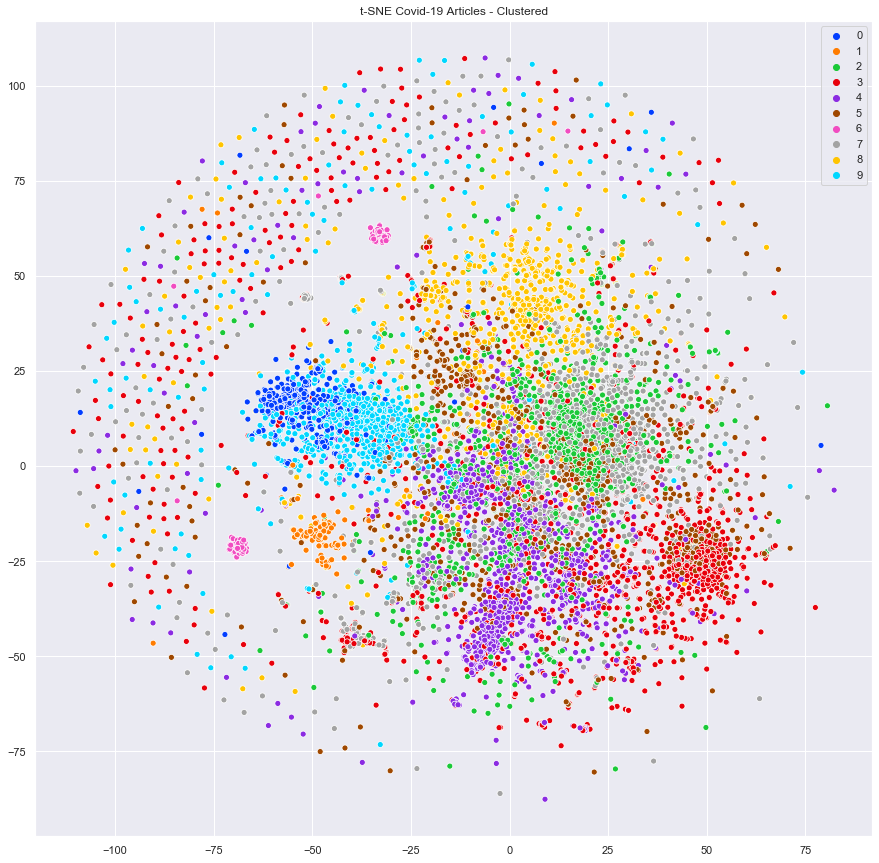

In [68]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# colors
palette = sns.color_palette("bright", len(set(y_pred)))

# plot
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y_pred, legend='full', palette=palette)
plt.title("t-SNE Covid-19 Articles - Clustered")
# plt.savefig("plots/t-sne_covid19_label.png")
plt.show()

That looks pretty promising. It can be seen that articles from the same cluster are near each other, forming groups. There are still overlaps. So we will have to see if we can improve this, for example by :
- By changing the cluster size
- Using another clustering algorithm, or different feature size.
- We can also consider not using 2-grams, or HashVectorizer.
- We can try 3-grams, 4-grams
- We can use plain text as our instances and vectorize them using either HashVectorizer, Tf-idfVectorizer.

It is also interesting that this cluster results look like real coronavirus shape :)

Before we try another method for clustering, we want to see how well it will classify using the labels we just created using K-Means.

<a id="6"></a> <br>
## Model's performances

In [69]:
# function to print out classification model report
def classification_report(model_name, test, pred):
    from sklearn.metrics import precision_score, recall_score
    from sklearn.metrics import accuracy_score
    from sklearn.metrics import f1_score
    
    print(model_name, ":\n")
    print("Accuracy Score: ", '{:,.3f}'.format(float(accuracy_score(test, pred)) * 100), "%")
    print("     Precision: ", '{:,.3f}'.format(float(precision_score(test, pred, average='micro')) * 100), "%")
    print("        Recall: ", '{:,.3f}'.format(float(recall_score(test, pred, average='micro')) * 100), "%")
    print("      F1 score: ", '{:,.3f}'.format(float(f1_score(test, pred, average='micro')) * 100), "%")

In [70]:
# random forest classifier instance
forest_clf = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=4)

# cross validation on the training set 
forest_scores = cross_val_score(forest_clf, X_train, y_train, cv=3, n_jobs=4)

# print out the mean of the cross validation scores
print("Accuracy: ", '{:,.3f}'.format(float(forest_scores.mean()) * 100), "%")

Accuracy:  67.750 %


In [71]:
# cross validate predict on the training set
forest_train_pred = cross_val_predict(forest_clf, X_train, y_train, cv=3, n_jobs=4)

# print precision and recall scores
print("Precision: ", '{:,.3f}'.format(float(precision_score(y_train, forest_train_pred, average='macro')) * 100), "%")
print("   Recall: ", '{:,.3f}'.format(float(recall_score(y_train, forest_train_pred, average='macro')) * 100), "%")

Precision:  77.664 %
   Recall:  64.428 %


In [72]:
# first train the model
forest_clf.fit(X_train, y_train)

# make predictions on the test set
forest_pred = forest_clf.predict(X_test)

In [73]:
# print out the classification report
classification_report("Random Forest Classifier Report (Test Set)", y_test, forest_pred)

Random Forest Classifier Report (Test Set) :

Accuracy Score:  69.308 %
     Precision:  69.308 %
        Recall:  69.308 %
      F1 score:  69.308 %


It looks like it doesn't overfit, which is good news. But results can be better than ~70-80%. So we might want to come back to this later again to see if we can improve it.

<a id="7"></a> <br>
## MiniBatchKMeans with Plain text and Tf-idf

Let's see if we will be able to get better clusters using plain text as instances rather than 2-grams and vectorize it using Tf-idf. Last time we separated the dataset into test and training sets because we wanted to do classification with the labels we got through clustering. This time we will just use all the dataset because the goal is to cluster all literature.

Let's use all df_covid here and not just 13000 rows.

In [13]:
vectorizer = TfidfVectorizer(max_features = 2**12)
X = vectorizer.fit_transform(df_covid['body_text'].values)

In [14]:
X.shape

(26044, 4096)

**PCA**

Let's see how much we can reduce the dimensions while still keeping 95% variance.

In [15]:
pca = PCA(n_components = 0.95)
X_reduced = pca.fit_transform(X.toarray())
X_reduced.shape

(26044, 2286)

Our shape has decreased by half (4096 to 2286).

Again, let's try to get our labels. We will choose 10 clusters again. This time, we will use MiniBatchKMeans as it is faster with more data:

In [16]:
k = 10
kmeans = MiniBatchKMeans(n_clusters=k)
y_pred = kmeans.fit_predict(X_reduced)

In [17]:
y = y_pred

**Dimensionality Reduction with t-SNE (Plain text and Tf-idf)**

Let's reduce the dimensionality using t-SNE again:

In [19]:
tsne = TSNE(verbose=1)
X_embedded = tsne.fit_transform(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 26044 samples in 0.164s...
[t-SNE] Computed neighbors for 26044 samples in 748.989s...
[t-SNE] Computed conditional probabilities for sample 1000 / 26044
[t-SNE] Computed conditional probabilities for sample 2000 / 26044
[t-SNE] Computed conditional probabilities for sample 3000 / 26044
[t-SNE] Computed conditional probabilities for sample 4000 / 26044
[t-SNE] Computed conditional probabilities for sample 5000 / 26044
[t-SNE] Computed conditional probabilities for sample 6000 / 26044
[t-SNE] Computed conditional probabilities for sample 7000 / 26044
[t-SNE] Computed conditional probabilities for sample 8000 / 26044
[t-SNE] Computed conditional probabilities for sample 9000 / 26044
[t-SNE] Computed conditional probabilities for sample 10000 / 26044
[t-SNE] Computed conditional probabilities for sample 11000 / 26044
[t-SNE] Computed conditional probabilities for sample 12000 / 26044
[t-SNE] Computed conditional probabilities for s

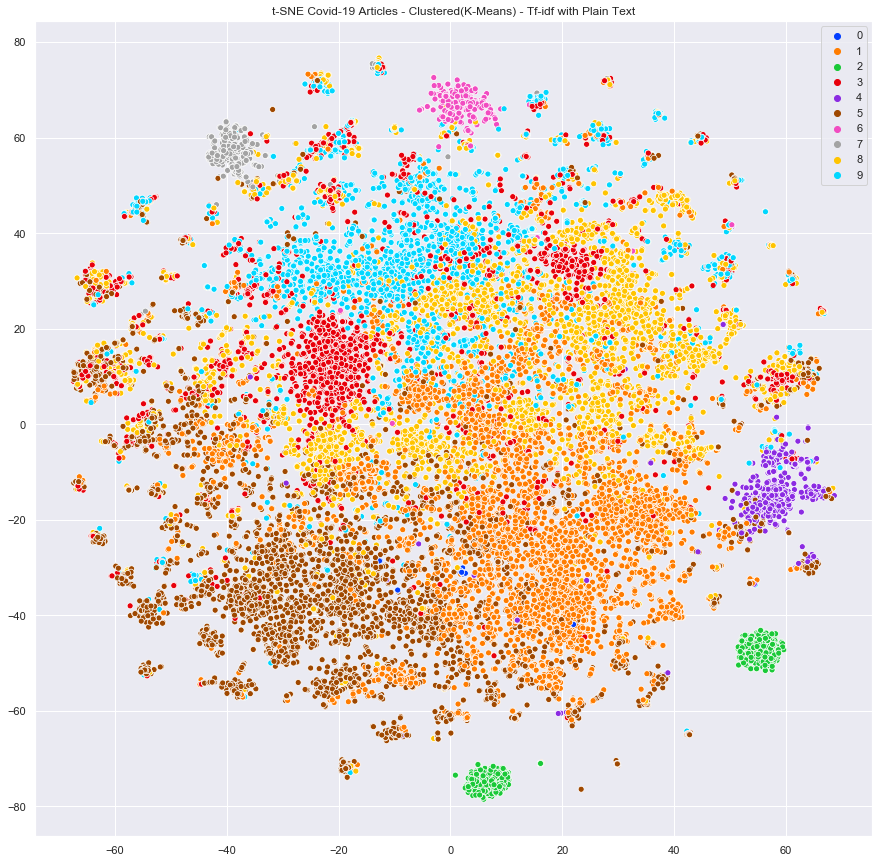

In [63]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# colors
palette = sns.color_palette("bright", len(set(y)))

# plot
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y, legend='full', palette=palette)
plt.title("t-SNE Covid-19 Articles - Clustered(K-Means) - Tf-idf with Plain Text")
# plt.savefig("plots/t-sne_covid19_label_TFID.png")
plt.show()


This time we are able to see the clusters more clearly. There are clusters that further apart from each other. I can also start to see that there is possibly more than 10 clusters we need to identify using k-means. But first let's see our model perfomances.

**Model performances**

In [64]:
# function to print out classification model report
def classification_report(model_name, test, pred):
    from sklearn.metrics import precision_score, recall_score
    from sklearn.metrics import accuracy_score
    from sklearn.metrics import f1_score
    
    print(model_name, ":\n")
    print("Accuracy Score: ", '{:,.3f}'.format(float(accuracy_score(test, pred)) * 100), "%")
    print("     Precision: ", '{:,.3f}'.format(float(precision_score(test, pred, average='macro')) * 100), "%")
    print("        Recall: ", '{:,.3f}'.format(float(recall_score(test, pred, average='macro')) * 100), "%")
    print("      F1 score: ", '{:,.3f}'.format(float(f1_score(test, pred, average='macro')) * 100), "%")

In [65]:
# test set size of 20% of the data and the random seed 42
X_train, X_test, y_train, y_test = train_test_split(X.toarray(),y_pred, test_size=0.2, random_state=42)

print("X_train size:", len(X_train))
print("X_test size:", len(X_test), "\n")

X_train size: 20835
X_test size: 5209 



In [66]:
# random forest classifier instance
forest_clf = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=4)

# cross validation on the training set 
forest_scores = cross_val_score(forest_clf, X_train, y_train, cv=3, n_jobs=4)

# print out the mean of the cross validation scores
print("Accuracy: ", '{:,.3f}'.format(float(forest_scores.mean()) * 100), "%")

Accuracy:  82.160 %


In [67]:
# cross validate predict on the training set
forest_train_pred = cross_val_predict(forest_clf, X_train, y_train, cv=3, n_jobs=4)

# print precision and recall scores
print("Precision: ", '{:,.3f}'.format(float(precision_score(y_train, forest_train_pred, average='macro')) * 100), "%")
print("   Recall: ", '{:,.3f}'.format(float(recall_score(y_train, forest_train_pred, average='macro')) * 100), "%")

Precision:  81.083 %
   Recall:  55.931 %


C:\Users\slimh\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [68]:
# first train the model
forest_clf.fit(X_train, y_train)

# make predictions on the test set
forest_pred = forest_clf.predict(X_test)

In [69]:
# print out the classification report
classification_report("Random Forest Classifier Report (Test Set)", y_test, forest_pred)

Random Forest Classifier Report (Test Set) :

Accuracy Score:  82.741 %
     Precision:  81.232 %
        Recall:  58.298 %
      F1 score:  61.437 %


C:\Users\slimh\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


**Dimensionality Reduction with PCA (Plain text and Tf-idf)**

t-SNE doesn't scale well. This is why run-time is larger than PCA with an average computer. Let's try to see if we can achieve good results with PCA as it scales very well with larger datasets and dimensions:

In [82]:
pca = PCA(n_components=3)
pca_result = pca.fit_transform(X.toarray())

Much faster than t-SNE as we could expect !

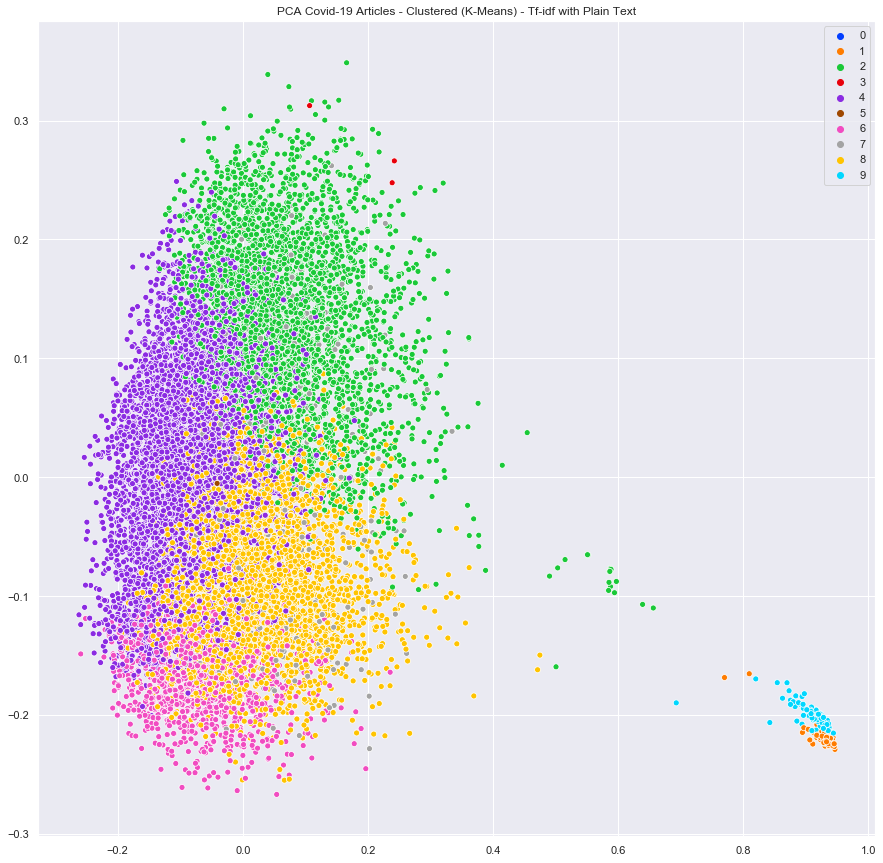

In [83]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# colors
palette = sns.color_palette("bright", len(set(y)))

# plot
sns.scatterplot(pca_result[:,0], pca_result[:,1], hue=y, legend='full', palette=palette)
plt.title("PCA Covid-19 Articles - Clustered (K-Means) - Tf-idf with Plain Text")
# plt.savefig("plots/pca_covid19_label_TFID.png")
plt.show()

I find this less clear and intuitive than t-SNE but it's subjective.

**More Clusters?**

On our previous plot we could see that there is potentially more clusters than only 10. Let's try to label them:

In [85]:
k = 20
kmeans = MiniBatchKMeans(n_clusters=k)
y_pred = kmeans.fit_predict(X)
y = y_pred

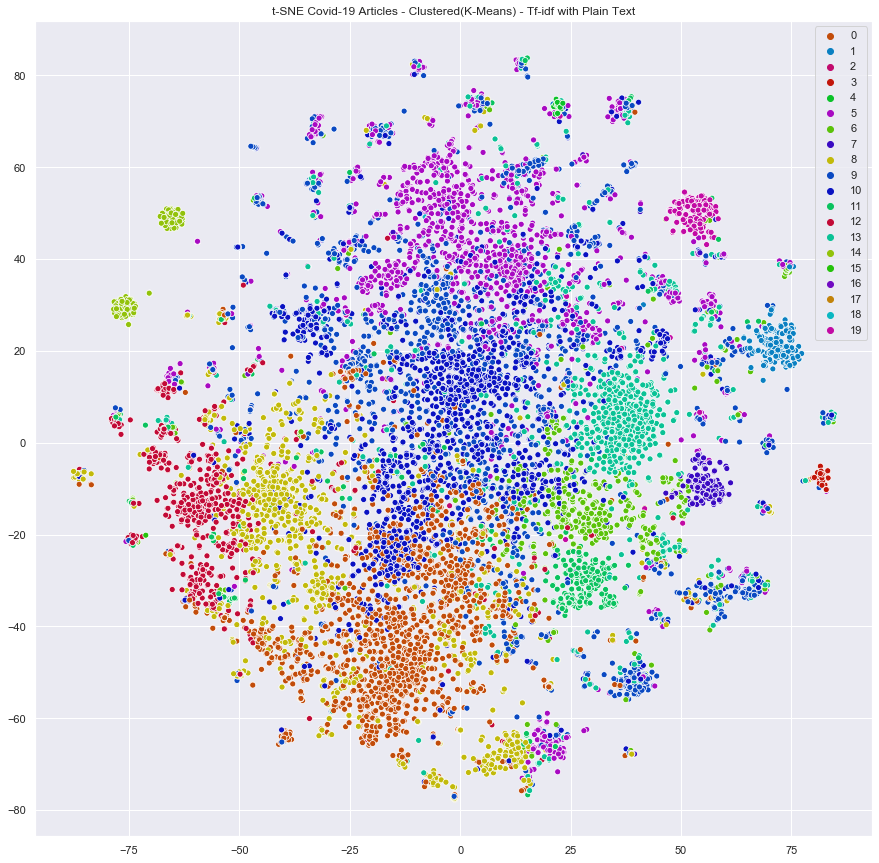

In [86]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# let's shuffle the list so distinct colors stay next to each other
palette = sns.hls_palette(20, l=.4, s=.9)
random.shuffle(palette)

# plot
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y, legend='full', palette=palette)
plt.title("t-SNE Covid-19 Articles - Clustered(K-Means) - Tf-idf with Plain Text")
# plt.savefig("plots/t-sne_covid19_20label_TFID.png")
plt.show()

Nice results, we can clearly see the clusters.

**Result's analyse with 10 clusters**

In [28]:
sentences = list(df_covid.title.dropna())

kmeans = MiniBatchKMeans(n_clusters=10).fit(X)
label = kmeans.labels_
clusters = {'Title': sentences, 'Label': label}
dfc = pd.DataFrame(clusters)
dfc.head()

,Title,Label
0,Immunity to Pathogens Taught by Specialized<b...,2
1,Public Health Responses to and Challenges for...,9
2,A Review of Pediatric Critical Care in<br>Res...,9
3,Function of the Deubiquitinating Enzyme USP46...,3
4,Evaluation of the tuberculosis programme in<b...,0


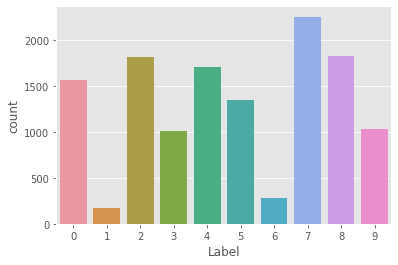

In [29]:
sns.countplot(dfc.Label);

In [38]:
stop_words = set(stopwords.words('english'))

stop_words.update(("et", "al", "de", "la", "Thu", "ie", "en", "un", "A", "el", "por"))

def freq_bigrams(x, terms):
    all_words = ' '.join([text for text in x])
    all_words = all_words.split()
    esBigrams = ngrams(all_words, 2)
    esBigramFreq = collections.Counter(esBigrams)
    bigrams = esBigramFreq.most_common(500) 
    tb=[]
    for bi in bigrams:
        if len([i for i in bi[0] if i not in stop_words])==2:
            tb.append(bi)
    d = pd.DataFrame({'bigram':[x[0] for x in tb[:terms]], 'count':[x[1] for x in tb[:terms]]})
    plt.figure(figsize=(20,5))
    ax = sns.barplot(data=d, x= "bigram", y = "count")
    ax.set(ylabel = 'Count')
    plt.show()

Overall distribution :


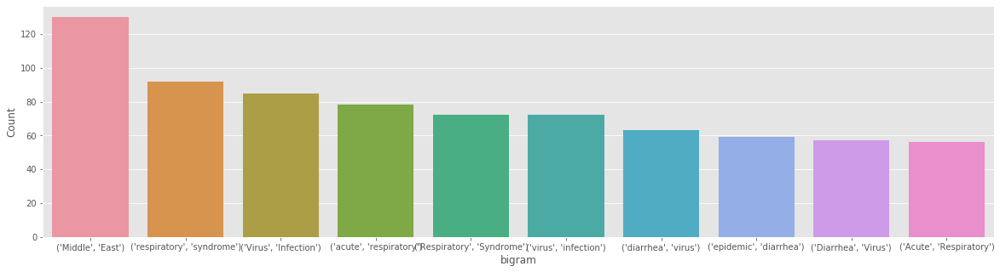

Class  0  distribution :


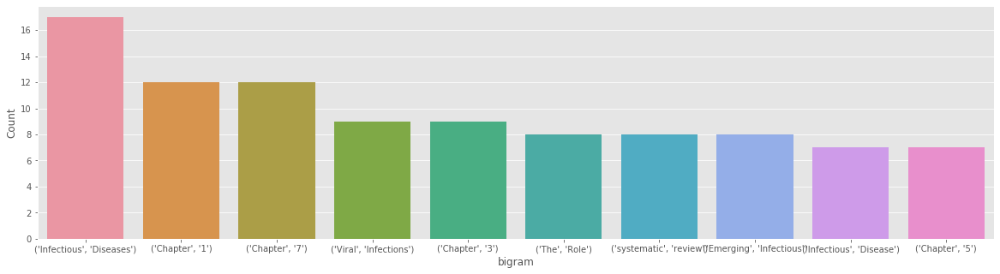

Class  1  distribution :


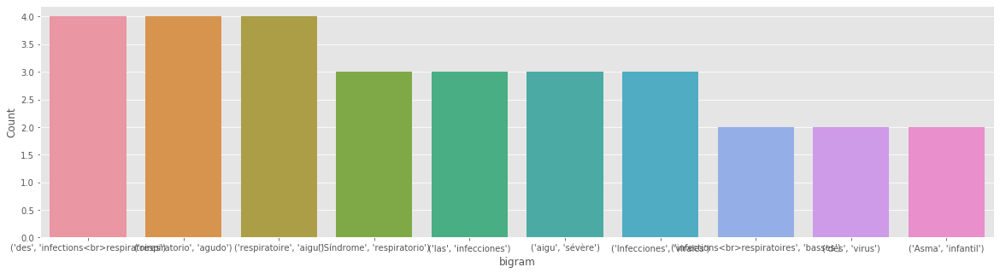

Class  2  distribution :


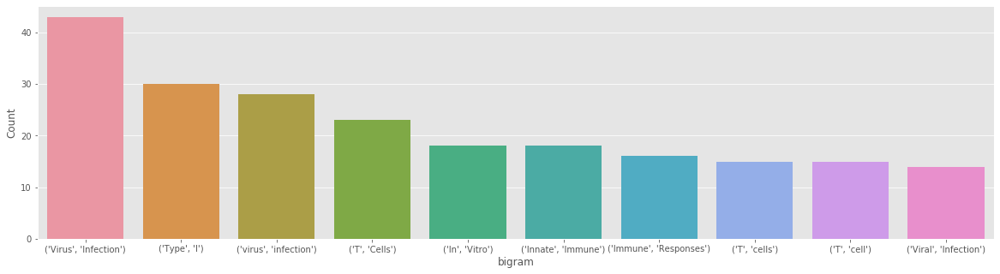

Class  3  distribution :


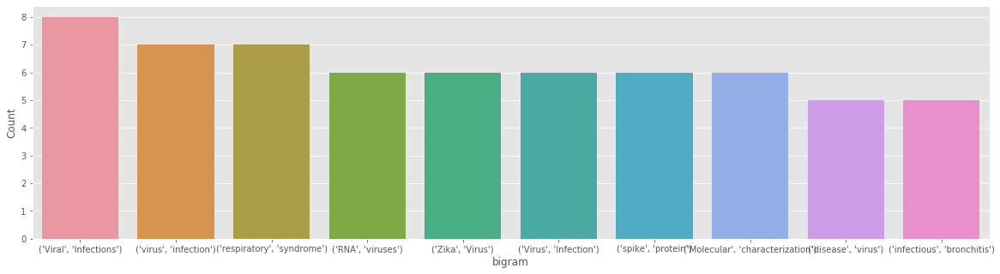

Class  4  distribution :


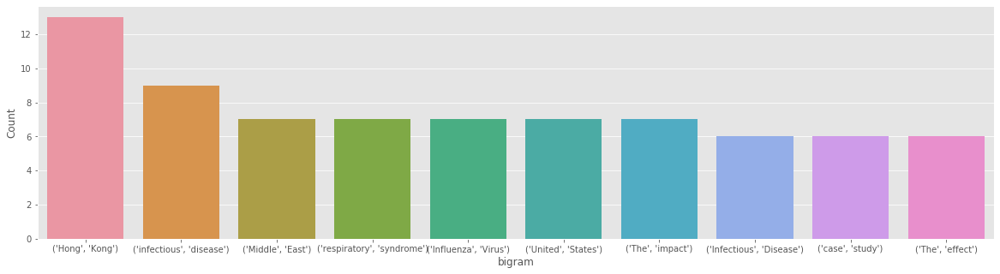

Class  5  distribution :


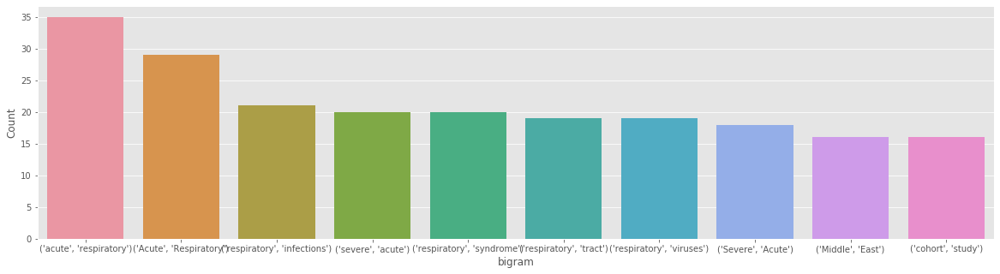

Class  6  distribution :


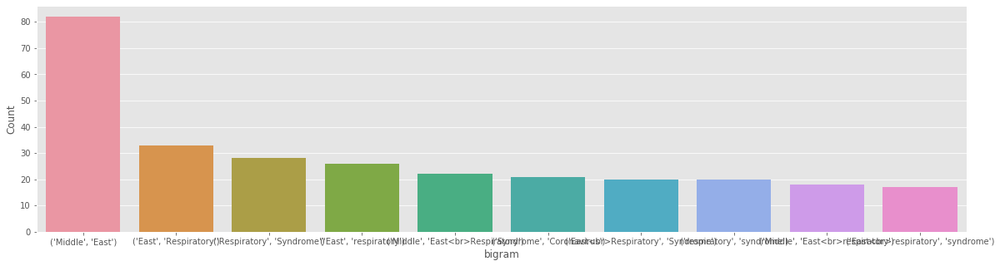

Class  7  distribution :


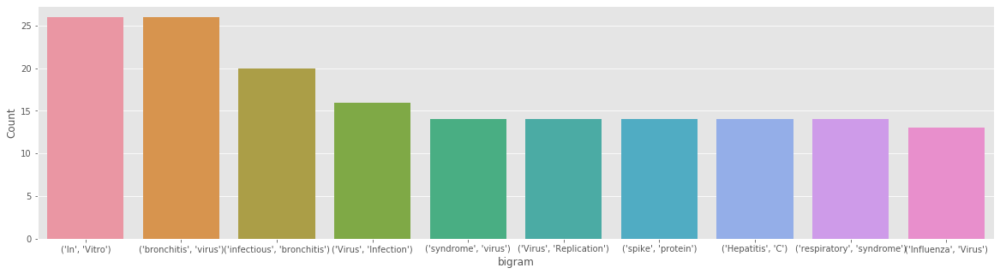

Class  8  distribution :


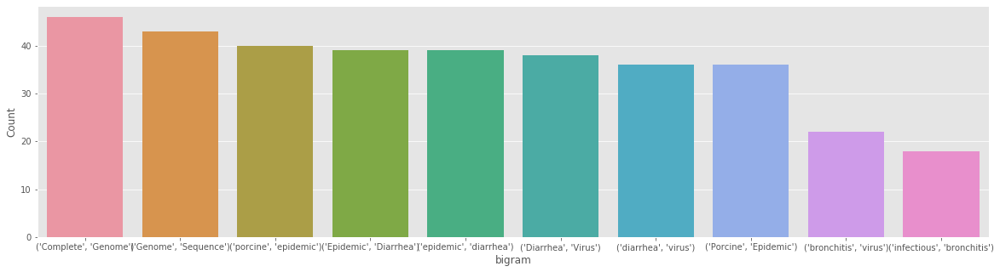

Class  9  distribution :


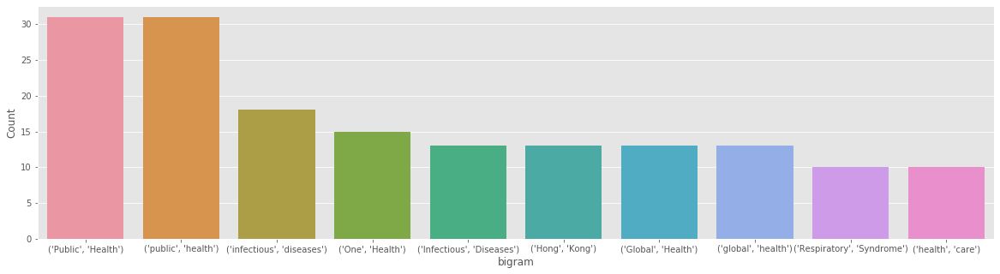

In [39]:
print('Overall distribution :' )
freq_bigrams(dfc.Title, 10)
for i in range(10):
    print('Class ', i,  ' distribution :' )
    freq_bigrams(dfc[dfc.Label==i].Title, 10)

We can see the most frequent bigram in each cluster. This kind of result could help to give known label to cluster and make our clustering more useful and readable. Let's see the more common word in each cluster.

In [49]:
#stop_words = set(stopwords.words("english")) 
lemmatizer = WordNetLemmatizer()

def clean_text(text):
    text = text.lower()
    text = re.sub(r'[^"[a-z][a-z][^\w\s\d+"]{2,}"]','',text, re.UNICODE)
    text = text.replace("[^a-zA-Z#]", " ")
    text = [lemmatizer.lemmatize(token, pos='v') for token in text.split(" ")]
    text = [word for word in text if not word in stop_words]
    text = [word for word in text if len(word) > 2]
    text = " ".join(text)
    return text
   

dfc['Title'] = dfc.Title.apply(lambda x: clean_text(x))

In [50]:
def freq_words(x, terms):
    all_words = ' '.join([text for text in x])
    all_words = all_words.split()
    
    fdist = FreqDist(all_words)
    words_df = pd.DataFrame({'word':list(fdist.keys()), 'count':list(fdist.values())})
    # selecting top N most frequent words
    d = words_df.nlargest(columns="count", n = terms) 
    #print(d)
    plt.figure(figsize=(20,5))
    ax = sns.barplot(data=d, x= "word", y = "count")
    ax.set(ylabel = 'Count')
    plt.show()

Overall distribution :


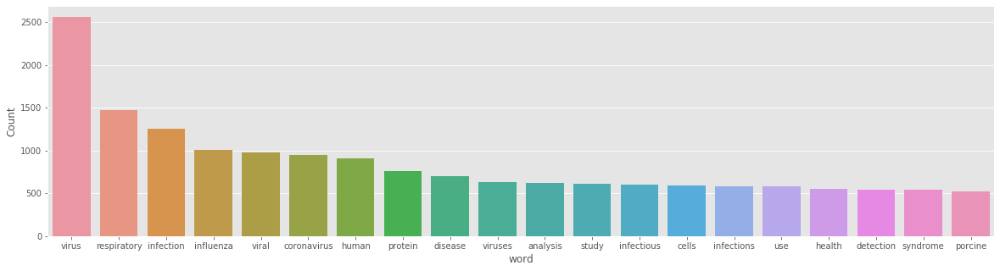

Class  0  distribution :


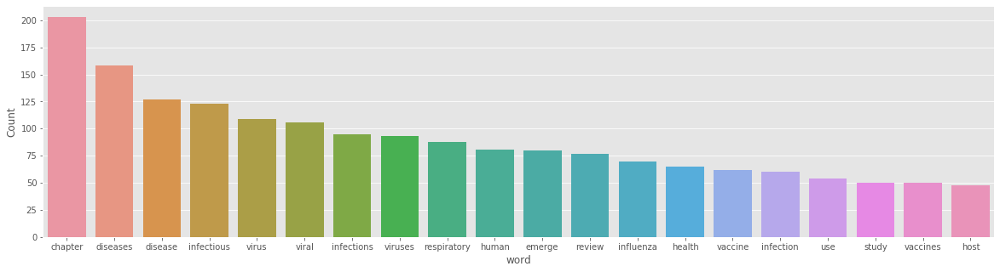

Class  1  distribution :


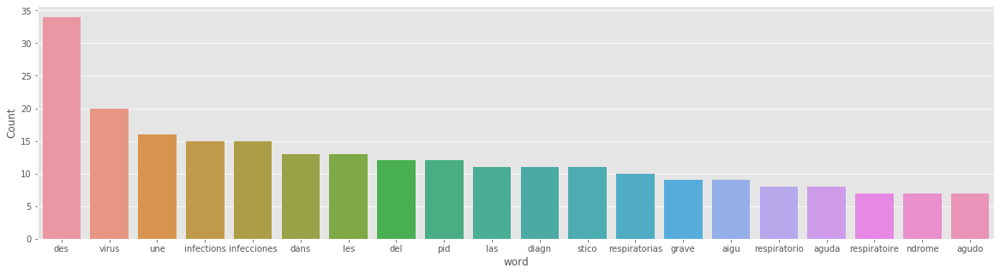

Class  2  distribution :


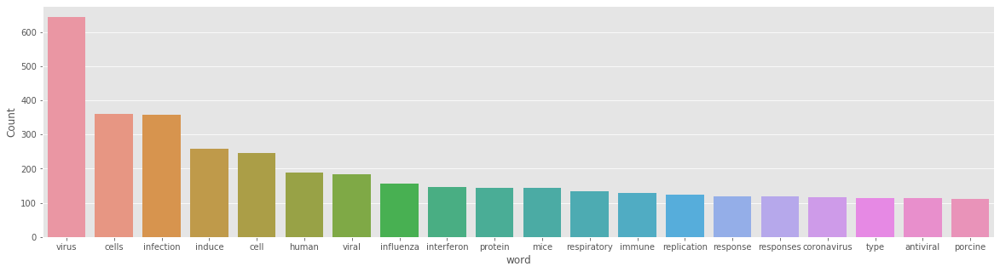

Class  3  distribution :


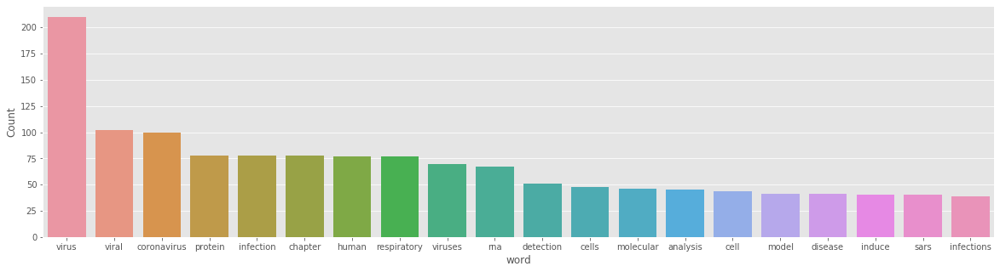

Class  4  distribution :


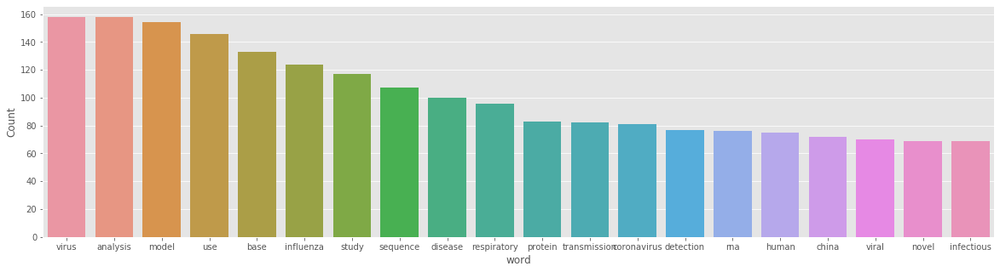

Class  5  distribution :


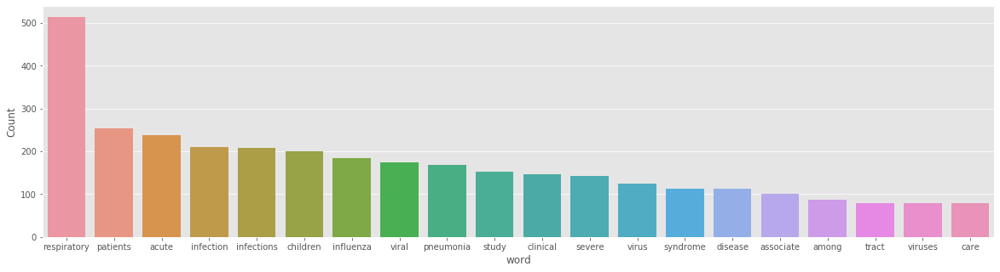

Class  6  distribution :


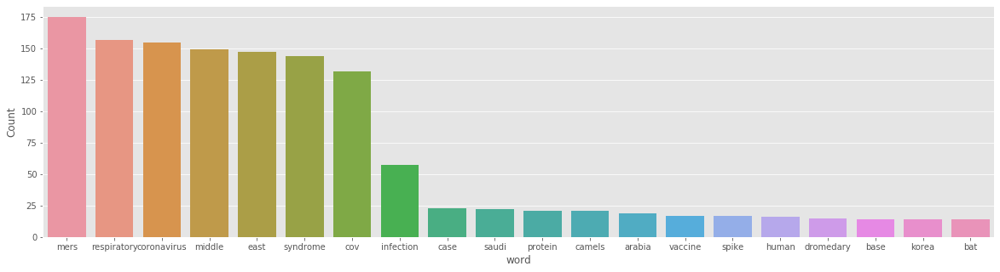

Class  7  distribution :


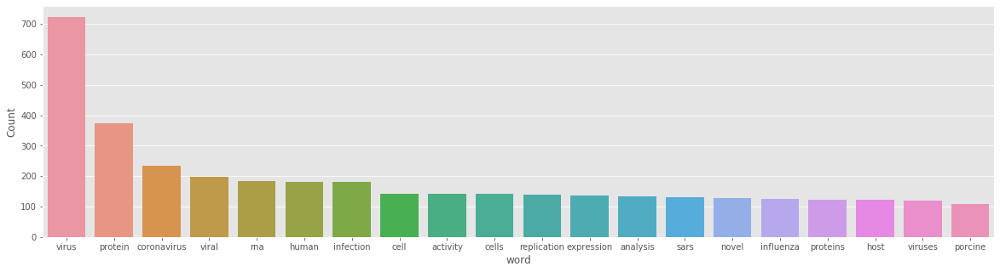

Class  8  distribution :


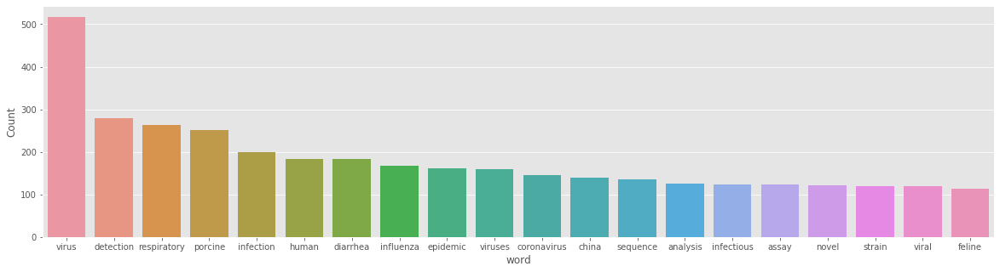

Class  9  distribution :


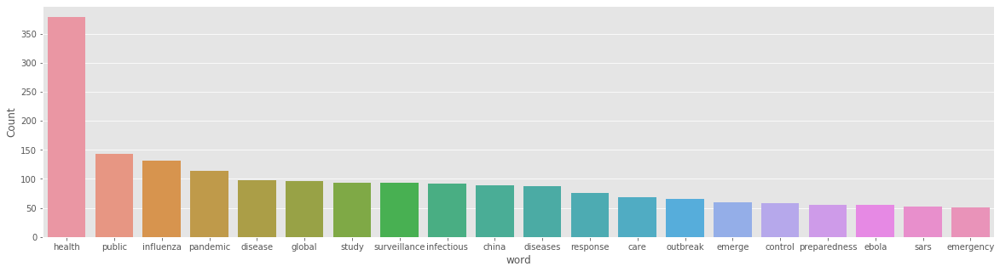

In [51]:
#Distribution of most frequent words in the 'Titles' data-set
print('Overall distribution :' )
freq_words(dfc.Title, 20)
for i in range(10):
    print('Class ', i,  ' distribution :' )
    freq_words(dfc[dfc.Label==i].Title, 20)

Again, this kind of information could lead to a cluster labelling. With more research and time put in it. Maybe later. 

Anyway, it would be helpful if we have a demo tool that can be used to see what articles are identified as similar using our Clustering and Dimensionality Reduction, right? Let's put together a interactive scatter plot of t-SNE to do that. We will do that with our model with 10 clusters.

**Interactive scatter plot of t-SNE with 10 clusters**

In [30]:
#from bokeh.resources import INLINE
#import bokeh.io

#BOKEH_RESSOURCES=INLINE

#bokeh.io.output_notebook(INLINE)


output_notebook()
y_labels = y_pred

# data sources
source = ColumnDataSource(data=dict(
    x= X_embedded[:,0], 
    y= X_embedded[:,1],
    x_backup = X_embedded[:,0],
    y_backup = X_embedded[:,1],
    desc= y_labels, 
    titles= df_covid['title'],
    authors = df_covid['authors'],
    journal = df_covid['journal'],
    abstract = df_covid['abstract_summary'],
    labels = ["C-" + str(x) for x in y_labels]
    ))

# hover over information
hover = HoverTool(tooltips=[
    ("Title", "@titles{safe}"),
    ("Author(s)", "@authors"),
    ("Journal", "@journal"),
    ("Abstract", "@abstract{safe}"),
],
                 point_policy="follow_mouse")

# map colors
mapper = linear_cmap(field_name='desc', 
                     palette=Category20[20],
                     low=min(y_labels) ,high=max(y_labels))

# prepare the figure
p = figure(plot_width=800, plot_height=800, 
           tools=[hover, 'pan', 'wheel_zoom', 'box_zoom', 'reset'], 
           title="t-SNE Covid-19 Articles, Clustered(Minibatchkmeans), Tf-idf with Plain Text", 
           toolbar_location="right")

# plot
p.scatter('x', 'y', size=5, 
          source=source,
          fill_color=mapper,
          line_alpha=0.3,
          line_color="black",
          legend_label = 'labels')

# add callback to control 
callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var radio_value = cb_obj.active;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            labels = data['desc'];
            
            if (radio_value == '20') {
                for (i = 0; i < x.length; i++) {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                }
            }
            else {
                for (i = 0; i < x.length; i++) {
                    if(labels[i] == radio_value) {
                        x[i] = x_backup[i];
                        y[i] = y_backup[i];
                    } else {
                        x[i] = undefined;
                        y[i] = undefined;
                    }
                }
            }


        source.change.emit();
        """)

# callback for searchbar
keyword_callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var text_value = cb_obj.value;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            abstract = data['abstract'];
            titles = data['titles'];
            authors = data['authors'];
            journal = data['journal'];

            for (i = 0; i < x.length; i++) {
                if(abstract[i].includes(text_value) || 
                   titles[i].includes(text_value) || 
                   authors[i].includes(text_value) || 
                   journal[i].includes(text_value)) {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                } else {
                    x[i] = undefined;
                    y[i] = undefined;
                }
            }
            


        source.change.emit();
        """)

# option
option = RadioButtonGroup(labels=["C-0", "C-1", "C-2",
                                  "C-3", "C-4", "C-5",
                                  "C-6", "C-7", "C-8",
                                  "C-9", "All"], 
                          active=10, callback=callback)

# search box
keyword = TextInput(title="Search:", callback=keyword_callback)

#header
header = Div(text="""<h1>COVID-19 Literature Cluster</h1>""")

# show
show(column(header, widgetbox(option, keyword),p))

Loading BokehJS ...

In [37]:
from bokeh.plotting import figure, output_file, save

#from bokeh.resources import INLINE
#import bokeh.io

#BOKEH_RESSOURCES=INLINE

#bokeh.io.output_notebook(INLINE)


output_notebook()
y_labels = y_pred

# data sources
source = ColumnDataSource(data=dict(
    x= X_embedded[:,0], 
    y= X_embedded[:,1],
    x_backup = X_embedded[:,0],
    y_backup = X_embedded[:,1],
    desc= y_labels, 
    titles= df_covid['title'],
    authors = df_covid['authors'],
    journal = df_covid['journal'],
    abstract = df_covid['abstract_summary'],
    labels = ["C-" + str(x) for x in y_labels]
    ))

# hover over information
hover = HoverTool(tooltips=[
    ("Title", "@titles{safe}"),
    ("Author(s)", "@authors"),
    ("Journal", "@journal"),
    ("Abstract", "@abstract{safe}"),
],
                 point_policy="follow_mouse")

# map colors
mapper = linear_cmap(field_name='desc', 
                     palette=Category20[20],
                     low=min(y_labels) ,high=max(y_labels))

# prepare the figure
p = figure(plot_width=800, plot_height=800, 
           tools=[hover, 'pan', 'wheel_zoom', 'box_zoom', 'reset'], 
           title="t-SNE Covid-19 Articles, Clustered(Minibatchkmeans), Tf-idf with Plain Text", 
           toolbar_location="right")

# plot
p.scatter('x', 'y', size=5, 
          source=source,
          fill_color=mapper,
          line_alpha=0.3,
          line_color="black",
          legend_label = 'labels')

# add callback to control 
callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var radio_value = cb_obj.active;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            labels = data['desc'];
            
            if (radio_value == '20') {
                for (i = 0; i < x.length; i++) {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                }
            }
            else {
                for (i = 0; i < x.length; i++) {
                    if(labels[i] == radio_value) {
                        x[i] = x_backup[i];
                        y[i] = y_backup[i];
                    } else {
                        x[i] = undefined;
                        y[i] = undefined;
                    }
                }
            }


        source.change.emit();
        """)

# callback for searchbar
keyword_callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var text_value = cb_obj.value;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            abstract = data['abstract'];
            titles = data['titles'];
            authors = data['authors'];
            journal = data['journal'];

            for (i = 0; i < x.length; i++) {
                if(abstract[i].includes(text_value) || 
                   titles[i].includes(text_value) || 
                   authors[i].includes(text_value) || 
                   journal[i].includes(text_value)) {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                } else {
                    x[i] = undefined;
                    y[i] = undefined;
                }
            }
            


        source.change.emit();
        """)

# option
option = RadioButtonGroup(labels=["C-0", "C-1", "C-2",
                                  "C-3", "C-4", "C-5",
                                  "C-6", "C-7", "C-8",
                                  "C-9", "All"], 
                          active=10, callback=callback)

# search box
keyword = TextInput(title="Search:", callback=keyword_callback)

#header
header = Div(text="""<h1>COVID-19 Literature Cluster</h1>""")

# show
#show(column(header, widgetbox(option, keyword),p))

output_file("interactiveplot.html", mode='inline')
save(column(header, widgetbox(option, keyword),p))

Loading BokehJS ...

'C:\\Users\\slimh\\PYTHON\\Projet titanic\\corona\\interactiveplot.html'


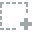
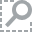
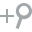
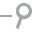
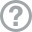
...
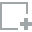
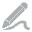
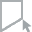
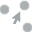
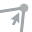

In [38]:
from IPython.display import HTML
HTML(filename='interactiveplot.html')

**If the html file doesn't show up, feel free to download and open the "interactiveplot.html" join with the notebook file in the folder to display it**

Just my thoughts but one way to make this interactive plot more useful could be to label the clusters, i.e. this is the "disease research" cluster and that's the "public health research" cluster, etc.. That might be helpful if a researcher want to use that kind of code ! It could be with the informations provided by our histograms above. It might be a good idea to see this more in depth later.

<a id="9"></a> <br>
## Doc2Vec for Text Representation and KMeans Clustering

Now, we return with a database who contain 13000 row for speed up cumputation.

In [58]:
document_tagged = []
tagged_count = 0
for _ in df_covid['body_text'].values:
    document_tagged.append(gensim.models.doc2vec.TaggedDocument(_,[tagged_count]))
    tagged_count += 1
print(tagged_count)

13000


In [59]:
import time
start_time = time.time()
d2v = Doc2Vec(document_tagged)

In [60]:
d2v.train(document_tagged,epochs=d2v.epochs,total_examples=d2v.corpus_count)
total_time = time.time()-start_time
print("Time consumed:",total_time)

Time consumed: 1028.8293235301971


In [62]:
X = np.array(d2v.docvecs.vectors_docs)

Let's us Elbow method again to find the optimal number of cluster :

In [ ]:
cost = []
for k in range(1,15):
    kmeans = KMeans(n_clusters = k, random_state = 222 ).fit(X)
    cost.append(kmeans.inertia_)

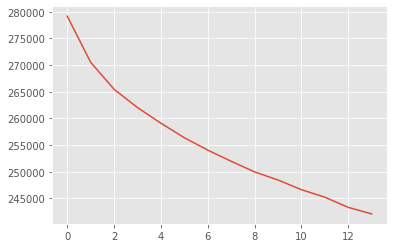

In [64]:
plt.plot(cost);

6 seems right.

In [66]:
k = 6
kmeans = KMeans(n_clusters=k)
y_pred = kmeans.fit_predict(X)

In [67]:
y = y_pred

**Dimensionality Reduction with t-SNE (Doc2Vec)**

Let's reduce the dimensionality using t-SNE again:

In [68]:
tsne = TSNE(verbose=1)
X_embedded = tsne.fit_transform(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 13000 samples in 0.267s...
[t-SNE] Computed neighbors for 13000 samples in 37.110s...
[t-SNE] Computed conditional probabilities for sample 1000 / 13000
[t-SNE] Computed conditional probabilities for sample 2000 / 13000
[t-SNE] Computed conditional probabilities for sample 3000 / 13000
[t-SNE] Computed conditional probabilities for sample 4000 / 13000
[t-SNE] Computed conditional probabilities for sample 5000 / 13000
[t-SNE] Computed conditional probabilities for sample 6000 / 13000
[t-SNE] Computed conditional probabilities for sample 7000 / 13000
[t-SNE] Computed conditional probabilities for sample 8000 / 13000
[t-SNE] Computed conditional probabilities for sample 9000 / 13000
[t-SNE] Computed conditional probabilities for sample 10000 / 13000
[t-SNE] Computed conditional probabilities for sample 11000 / 13000
[t-SNE] Computed conditional probabilities for sample 12000 / 13000
[t-SNE] Computed conditional probabilities for sa

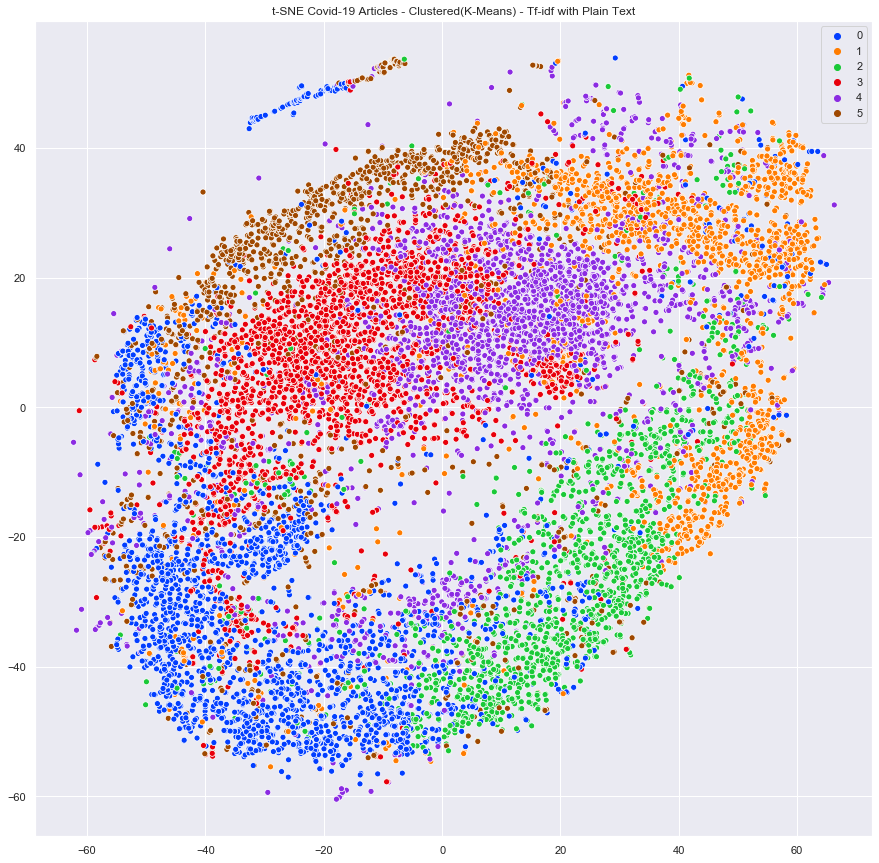

In [69]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# colors
palette = sns.color_palette("bright", len(set(y)))

# plot
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y, legend='full', palette=palette)
plt.title("t-SNE Covid-19 Articles - Clustered(K-Means) - Tf-idf with Plain Text")
# plt.savefig("plots/t-sne_covid19_label_TFID.png")
plt.show()

We are able to see the clusters clearly. The clusters are further apart from each other.

**Dimensionality Reduction with PCA (Doc2Vec)**

In [72]:
pca = PCA(n_components=3)
pca_result = pca.fit_transform(X)

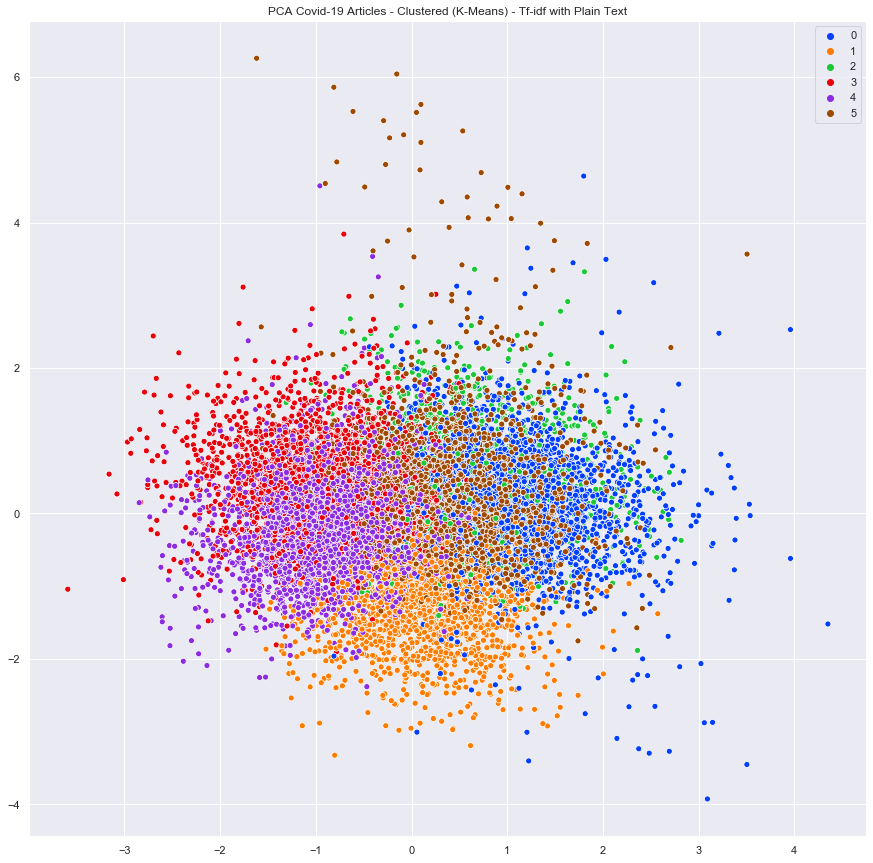

In [73]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# colors
palette = sns.color_palette("bright", len(set(y)))

# plot
sns.scatterplot(pca_result[:,0], pca_result[:,1], hue=y, legend='full', palette=palette)
plt.title("PCA Covid-19 Articles - Clustered (K-Means) - Tf-idf with Plain Text")
# plt.savefig("plots/pca_covid19_label_TFID.png")
plt.show()

Hmm, I find it less clearly, but this differs for each individual. It's clearly much faster, that's convenient.

<a id="11"></a> <br>
## AgglomerativeClustering with TF-IDF

Agglomerative clustering is really a suite of algorithms all based on the same idea. The fundamental idea is that you start with each point in it’s own cluster and then, for each cluster, use some criterion to choose another cluster to merge with.

In [36]:
vectorizer = TfidfVectorizer(max_features = 2**12)
X = vectorizer.fit_transform(df_covid['body_text'].values)

In [38]:
AC = AgglomerativeClustering(n_clusters=10)

y_pred = AC.fit_predict(X.toarray())

y = y_pred

Dimensionality Reduction with t-SNE (AgglomerativeClustering)

Let's reduce the dimensionality using t-SNE again:

In [39]:
tsne = TSNE(verbose=1)
X_embedded = tsne.fit_transform(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 13000 samples in 0.103s...
[t-SNE] Computed neighbors for 13000 samples in 185.331s...
[t-SNE] Computed conditional probabilities for sample 1000 / 13000
[t-SNE] Computed conditional probabilities for sample 2000 / 13000
[t-SNE] Computed conditional probabilities for sample 3000 / 13000
[t-SNE] Computed conditional probabilities for sample 4000 / 13000
[t-SNE] Computed conditional probabilities for sample 5000 / 13000
[t-SNE] Computed conditional probabilities for sample 6000 / 13000
[t-SNE] Computed conditional probabilities for sample 7000 / 13000
[t-SNE] Computed conditional probabilities for sample 8000 / 13000
[t-SNE] Computed conditional probabilities for sample 9000 / 13000
[t-SNE] Computed conditional probabilities for sample 10000 / 13000
[t-SNE] Computed conditional probabilities for sample 11000 / 13000
[t-SNE] Computed conditional probabilities for sample 12000 / 13000
[t-SNE] Computed conditional probabilities for s

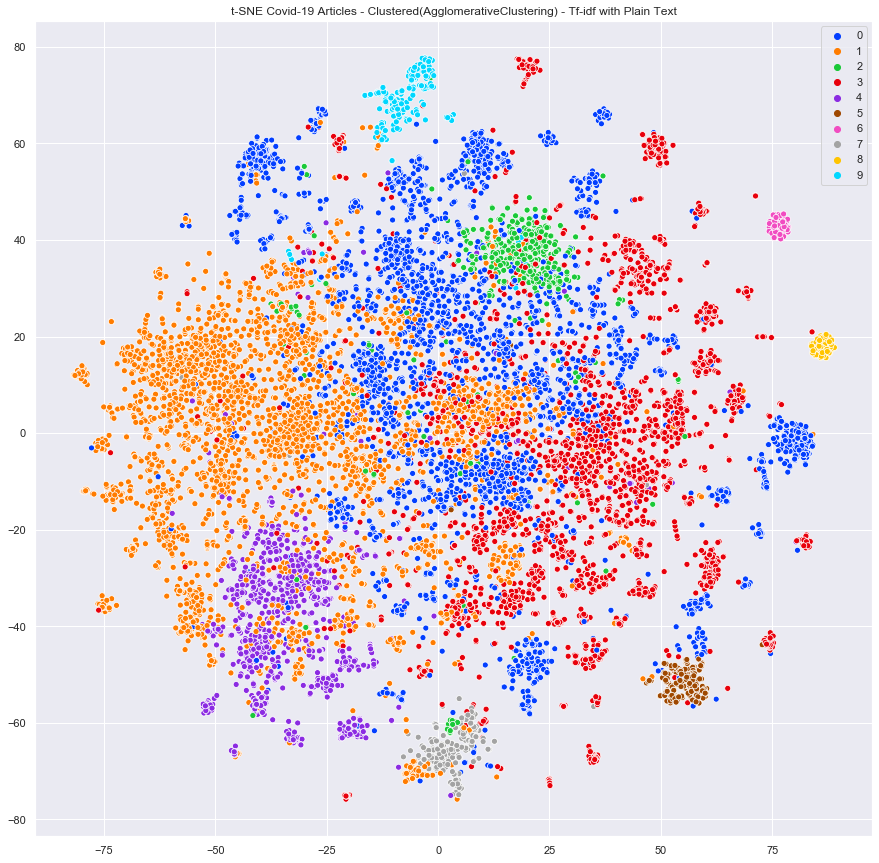

In [41]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# colors
palette = sns.color_palette("bright", len(set(y)))

# plot
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y, legend='full', palette=palette)
plt.title("t-SNE Covid-19 Articles - Clustered(AgglomerativeClustering) - Tf-idf with Plain Text")
# plt.savefig("plots/t-sne_covid19_label_TFID.png")
plt.show()

That's kind of chaotic, I would rather use the Kmeans but that's subjective.

<a id="12"></a> <br>
## SpectralClustering with TF-IDF

In [15]:
vectorizer = TfidfVectorizer(max_features = 2**12)
X = vectorizer.fit_transform(df_covid['body_text'].values)

In [16]:
SC = SpectralClustering(n_clusters=10)

y_pred = SC.fit_predict(X.toarray())

y = y_pred

In [17]:
tsne = TSNE(verbose=1)
X_embedded = tsne.fit_transform(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 13000 samples in 0.069s...
[t-SNE] Computed neighbors for 13000 samples in 99.687s...
[t-SNE] Computed conditional probabilities for sample 1000 / 13000
[t-SNE] Computed conditional probabilities for sample 2000 / 13000
[t-SNE] Computed conditional probabilities for sample 3000 / 13000
[t-SNE] Computed conditional probabilities for sample 4000 / 13000
[t-SNE] Computed conditional probabilities for sample 5000 / 13000
[t-SNE] Computed conditional probabilities for sample 6000 / 13000
[t-SNE] Computed conditional probabilities for sample 7000 / 13000
[t-SNE] Computed conditional probabilities for sample 8000 / 13000
[t-SNE] Computed conditional probabilities for sample 9000 / 13000
[t-SNE] Computed conditional probabilities for sample 10000 / 13000
[t-SNE] Computed conditional probabilities for sample 11000 / 13000
[t-SNE] Computed conditional probabilities for sample 12000 / 13000
[t-SNE] Computed conditional probabilities for sa

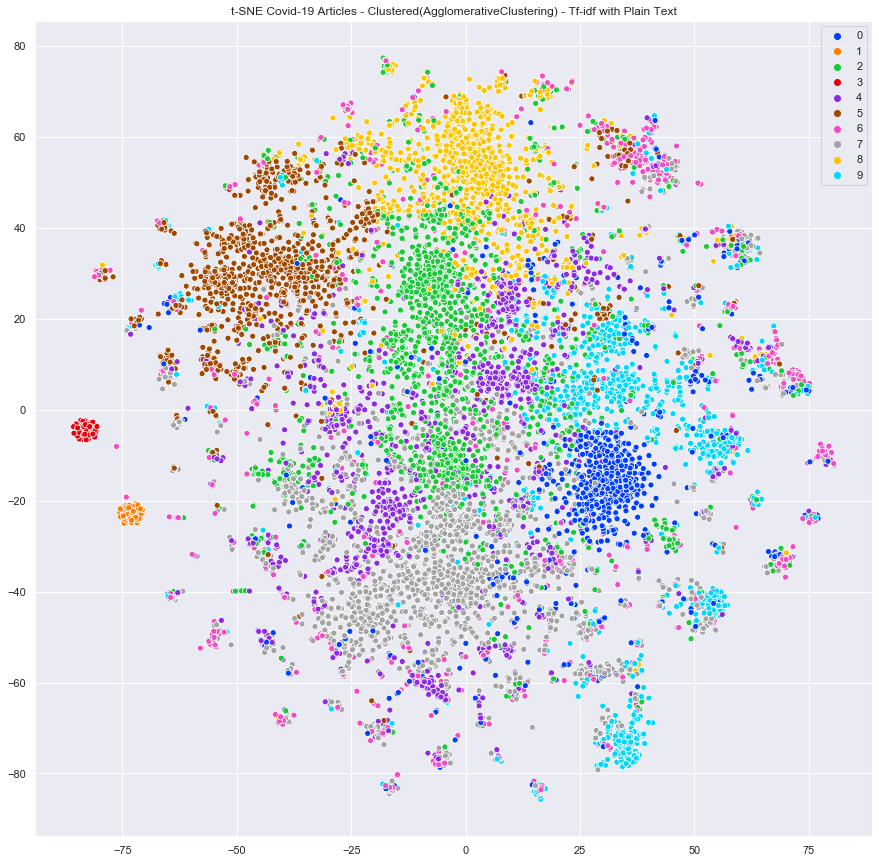

In [18]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# colors
palette = sns.color_palette("bright", len(set(y)))

# plot
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y, legend='full', palette=palette)
plt.title("t-SNE Covid-19 Articles - Clustered(AgglomerativeClustering) - Tf-idf with Plain Text")
# plt.savefig("plots/t-sne_covid19_label_TFID.png")
plt.show()

Again, I rather prefer the Kmeans output, more clear and less chaotic.

That's wrap up my work on the COVID-19. I tried several clustering methods, and several pre processing as well. My personal preference goes to MiniBatchKMeans with t-sne. It's both fast and readable. This project could be more investigated, particularly for annotate the clusters labels, for interpretation purpose. If I have the time later, myabe I will work on it.

Wait and see.

Be safe.